# 1b. OSM数据的内在分析
该笔记本分析给定区域的 OSM 自行车基础设施数据的质量。 质量评估是“内在的”，即仅基于一个输入数据集，而不使用外部信息。 对于将 OSM 数据与用户提供的参考数据集进行比较的外在质量评估，请参阅笔记本 3a 和 3b。

该分析评估给定区域 OSM 数据的“目的适应性”（[Barron et al., 2014](https://onlinelibrary.wiley.com/doi/10.1111/tgis.12073)）。 分析的结果可能与自行车规划和研究相关 - 特别是对于包括自行车基础设施网络分析的项目，在这种情况下，几何拓扑尤为重要。

由于评估不使用外部参考数据集作为基本事实，因此无法对数据质量做出普遍的声明。 这个想法是让那些使用基于 OSM 的自行车网络的人能够评估数据是否足以满足他们的特定用例。 该分析有助于发现潜在的数据质量问题，但将结果的最终解释权留给用户。

该笔记本利用了一系列先前调查 OSM/VGI 数据质量的项目的质量指标，例如 [Ferster et al. (2020)](https://www.tandfonline.com/doi/full/10.1080/15568318.2018.1519746), [Hochmair et al. (2015)](https://onlinelibrary.wiley.com/doi/abs/10.1111/tgis.12081), [Barron et al. (2014)](https://onlinelibrary.wiley.com/doi/10.1111/tgis.12073), and [Neis et al. (2012](https://www.mdpi.com/1999-5903/4/1/1))。

<div class="alert alert-block alert-info">
<b>Prerequisites &amp; Input/Output</b>
<p>
提前运行笔记本 1a。
    
该笔记本的输出文件（数据、地图、绘图）保存到<span style="font-family:courier;">../results/OSM/[study_area]/</span> subfolders.
</p>
</div>

<div class="alert alert-block alert-info">
<b>Familiarity required</b>
<p>
为了正确解释一些空间数据质量指标，需要对该区域有一定的了解。
</p>
</div>



In [1]:
# Load libraries, settings and data

import json
import pickle
import warnings
from collections import Counter
import math

import contextily as cx
import folium
import geopandas as gpd
import matplotlib as mpl
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import numpy as np
import osmnx as ox
import pandas as pd
import yaml
from matplotlib import cm, colors

from src import evaluation_functions as eval_func
from src import plotting_functions as plot_func

%run ../settings/yaml_variables.py
%run ../settings/plotting.py
%run ../settings/tiledict.py
%run ../settings/load_osmdata.py
%run ../settings/df_styler.py
%run ../settings/paths.py

warnings.filterwarnings("ignore")

grid = osm_grid

D:\tmp_resource\BikeDNA-main\BikeDNA-main\scripts\settings\plotting.py:49: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmap_name, n)
D:\tmp_resource\BikeDNA-main\BikeDNA-main\scripts\settings\plotting.py:46: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmap_name)


OSM graphs loaded successfully!
OSM data loaded successfully!


<string>:49: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
<string>:46: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


## 数据完整性

### 网络密度

在此设置中，网络密度是指边的长度或每平方公里的节点数。 这是空间（道路）网络中网络密度的通常定义，它与网络科学中更常见的“结构”网络密度不同。 如果不与参考数据集进行比较，网络密度本身并不表明空间数据质量。 然而，对于熟悉研究区域的任何人来说，网络密度可以表明该区域的某些部分是否映射不足或过度。

**方法**

这里的密度不是基于边缘的几何长度，而是基于基础设施的计算长度。 例如，一条 100 米长的双向路径贡献了 200 米的自行车基础设施。 该方法用于考虑绘制自行车基础设施的不同方式，否则可能会导致网络密度出现较大偏差。 使用“compute_network_densis”，可以计算每单位面积的元素数量（节点、悬空节点和基础设施总长度）。 密度计算两次：首先计算整个网络的研究区域（“全局密度”），然后计算每个网格单元（“局部密度”）。 全局和局部密度都是针对整个网络以及受保护和未受保护的基础设施计算的。

**解释**

由于此处进行的分析是内在的，即不使用外部信息，因此无法知道低密度值是由于测绘不完整还是由于该地区实际缺乏基础设施所致。 然而，网格单元密度值的比较可以提供一些见解，例如：
* 基础设施密度低于平均水平表明局部网络较为稀疏
* 高于平均节点密度表明网格单元内交叉点相对较多
* 悬挂节点密度高于平均水平表明网格单元中存在相对较多的死角

#### 全球网络密度

<br />

In [2]:
# Entire study area
edge_density, node_density, dangling_node_density = eval_func.compute_network_density(
    (osm_edges_simplified, osm_nodes_simplified),
    grid.unary_union.area,
    return_dangling_nodes=True,
)

density_results = {}
density_results["edge_density_m_sqkm"] = edge_density
density_results["node_density_count_sqkm"] = node_density
density_results["dangling_node_density_count_sqkm"] = dangling_node_density

osm_protected = osm_edges_simplified.loc[osm_edges_simplified.protected == "protected"]
osm_unprotected = osm_edges_simplified.loc[
    osm_edges_simplified.protected == "unprotected"
]
osm_mixed = osm_edges_simplified.loc[osm_edges_simplified.protected == "mixed"]

osm_data = [osm_protected, osm_unprotected, osm_mixed]
labels = ["protected_density", "unprotected_density", "mixed_density"]

for data, label in zip(osm_data, labels):
    if len(data) > 0:
        osm_edge_density_type, _ = eval_func.compute_network_density(
            (data, osm_nodes_simplified),
            grid.unary_union.area,
            return_dangling_nodes=False,
        )
        density_results[label + "_m_sqkm"] = osm_edge_density_type
    else:
        density_results[label + "_m_sqkm"] = 0

protected_edge_density = density_results["protected_density_m_sqkm"]
unprotected_edge_density = density_results["unprotected_density_m_sqkm"]
mixed_protection_edge_density = density_results["mixed_density_m_sqkm"]

print(f"For the entire study area, there are:")
print(f"- {edge_density:.2f} meters of bicycle infrastructure per km2.")
print(f"- {node_density:.2f} nodes in the bicycle network per km2.")
print(
    f"- {dangling_node_density:.2f} dangling nodes in the bicycle network per km2."
)
print(
    f"- {protected_edge_density:.2f} meters of protected bicycle infrastructure per km2."
)
print(
    f"- {unprotected_edge_density:.2f} meters of unprotected bicycle infrastructure per km2."
)
print(
    f"- {mixed_protection_edge_density:.2f} meters of mixed protection bicycle infrastructure per km2."
)

For the entire study area, there are:
- 5824.58 meters of bicycle infrastructure per km2.
- 27.65 nodes in the bicycle network per km2.
- 10.08 dangling nodes in the bicycle network per km2.
- 5342.41 meters of protected bicycle infrastructure per km2.
- 427.35 meters of unprotected bicycle infrastructure per km2.
- 54.82 meters of mixed protection bicycle infrastructure per km2.


In [3]:
# Save stats to csv
pd.DataFrame(
    {
        "metric": [
            "meters of bicycle infrastructure per square km",
            "nodes in the bicycle network per square km",
            "dangling nodes in the bicycle network per square km",
            "meters of protected bicycle infrastructure per square km",
            "meters of unprotected bicycle infrastructure per square km",
            "meters of mixed protection bicycle infrastructure per square km",
        ],
        "value": [
            np.round(edge_density, 2),
            np.round(node_density, 2),
            np.round(dangling_node_density, 2),
            np.round(protected_edge_density, 2),
            np.round(unprotected_edge_density, 2),
            np.round(mixed_protection_edge_density, 2),
        ],
    }
).to_csv(osm_results_data_fp + "stats_area.csv", index=False)

#### 本地网络密度

In [4]:
# Per grid cell
results_dict = {}
data = (osm_edges_simp_joined, osm_nodes_simp_joined.set_index("osmid"))

[
    eval_func.run_grid_analysis(
        grid_id,
        data,
        results_dict,
        eval_func.compute_network_density,
        grid["geometry"].loc[grid.grid_id == grid_id].area.values[0],
        return_dangling_nodes=True,
    )
    for grid_id in grid_ids
]

results_df = pd.DataFrame.from_dict(results_dict, orient="index")
results_df.reset_index(inplace=True)
results_df.rename(
    columns={
        "index": "grid_id",
        0: "osm_edge_density",
        1: "osm_node_density",
        2: "osm_dangling_node_density",
    },
    inplace=True,
)

grid = eval_func.merge_results(grid, results_df, "left")

osm_protected = osm_edges_simp_joined.loc[
    osm_edges_simp_joined.protected == "protected"
]
osm_unprotected = osm_edges_simp_joined.loc[
    osm_edges_simp_joined.protected == "unprotected"
]
osm_mixed = osm_edges_simp_joined.loc[osm_edges_simp_joined.protected == "mixed"]

osm_data = [osm_protected, osm_unprotected, osm_mixed]

osm_labels = ["osm_protected_density", "osm_unprotected_density", "osm_mixed_density"]

for data, label in zip(osm_data, osm_labels):
    if len(data) > 0:
        results_dict = {}
        data = (osm_edges_simp_joined.loc[data.index], osm_nodes_simp_joined)
        [
            eval_func.run_grid_analysis(
                grid_id,
                data,
                results_dict,
                eval_func.compute_network_density,
                grid["geometry"].loc[grid.grid_id == grid_id].area.values[0],
            )
            for grid_id in grid_ids
        ]

        results_df = pd.DataFrame.from_dict(results_dict, orient="index")
        results_df.reset_index(inplace=True)
        results_df.rename(columns={"index": "grid_id", 0: label}, inplace=True)
        results_df.drop(1, axis=1, inplace=True)

        grid = eval_func.merge_results(grid, results_df, "left")

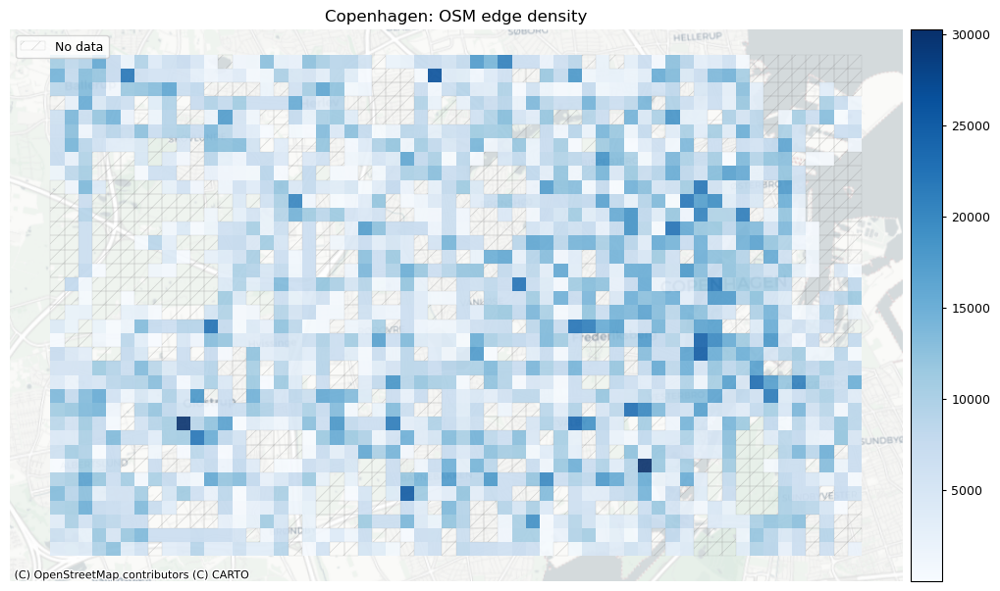

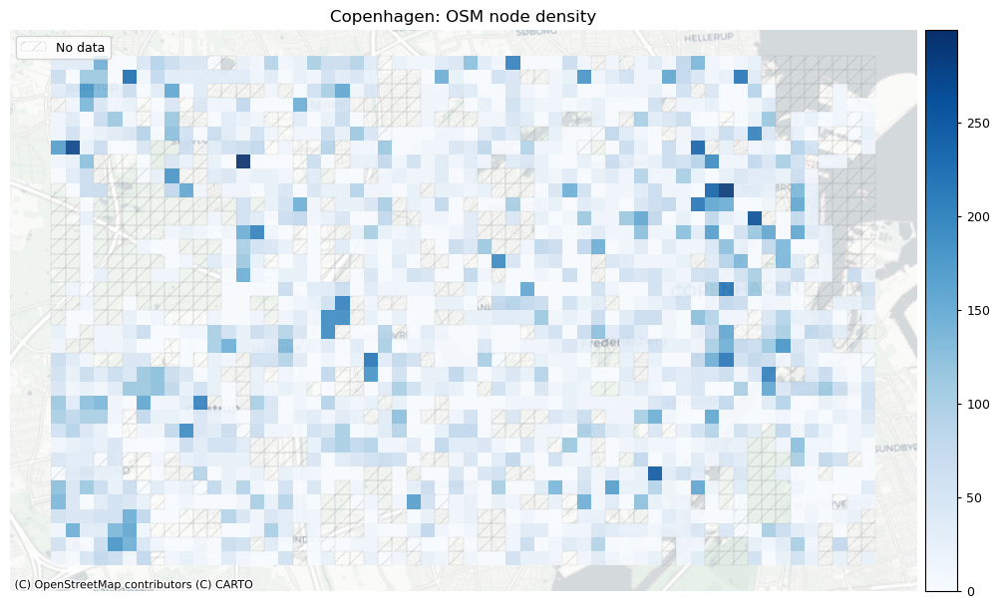

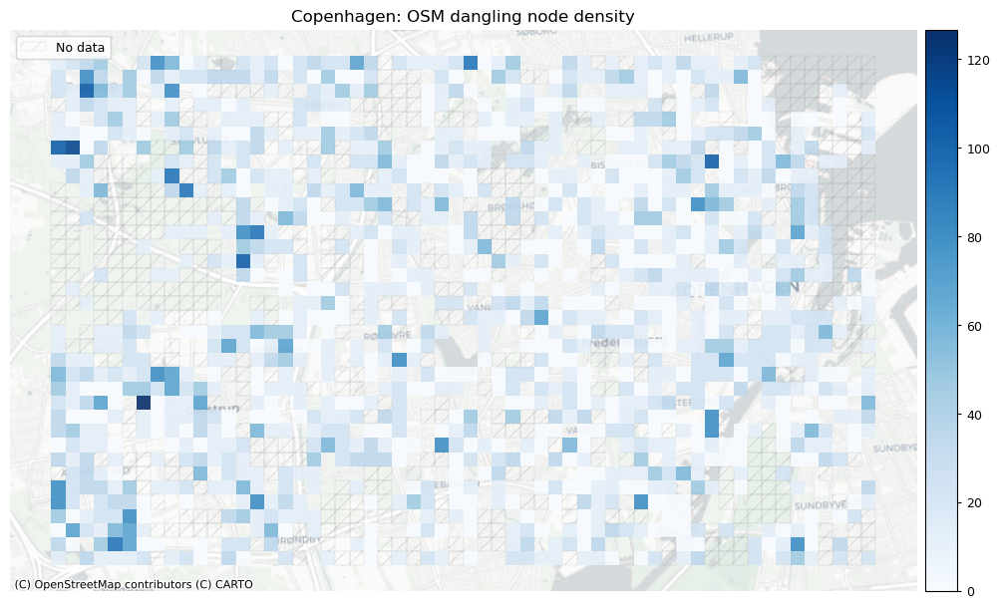

In [5]:
# Network density grid plots
         
set_renderer(renderer_map)
plot_cols = ["osm_edge_density", "osm_node_density", "osm_dangling_node_density"]
plot_titles = [
    area_name+": OSM edge density",
    area_name+": OSM node density",
    area_name+": OSM dangling node density",
]
filepaths = [
    osm_results_static_maps_fp + "density_edge_osm",
    osm_results_static_maps_fp + "density_node_osm",
    osm_results_static_maps_fp + "density_danglingnode_osm",
]
cmaps = [pdict["pos"], pdict["pos"], pdict["pos"]]
no_data_cols = ["count_osm_edges", "count_osm_nodes", "count_osm_nodes"]

plot_func.plot_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=plot_titles,
    filepaths=filepaths,
    cmaps=cmaps,
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=no_data_cols,
)

#### 受保护和未受保护基础设施的密度

在 BikeDNA 中，“受保护的基础设施”是指通过高架路缘、护柱或其他物理屏障等与汽车交通分开的所有自行车基础设施，或者不毗邻街道的自行车道。

*不受保护的基础设施*是专门供骑自行车者使用的所有其他类型的车道，但仅通过汽车交通分隔，例如街道上的画线。

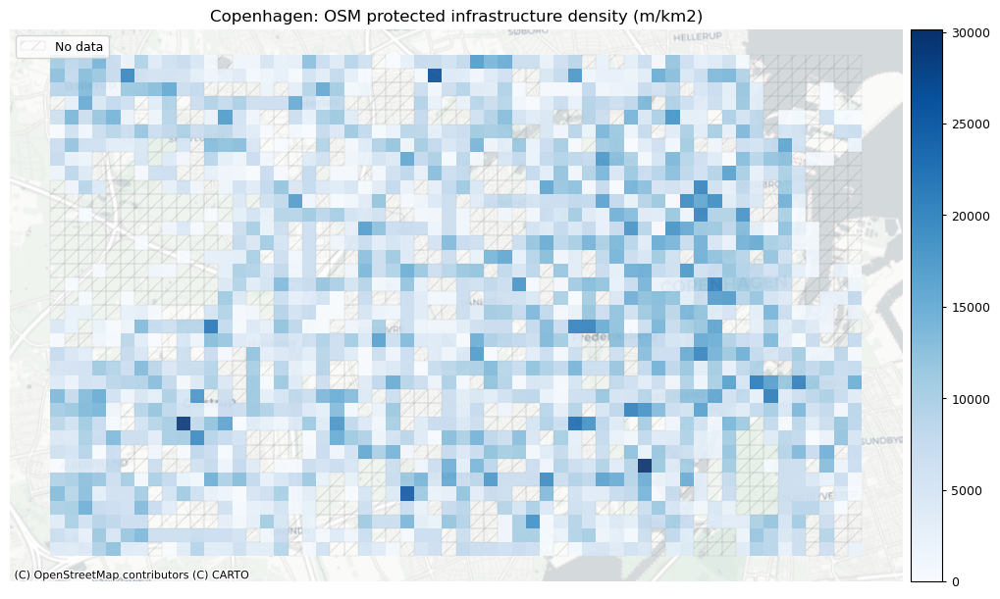

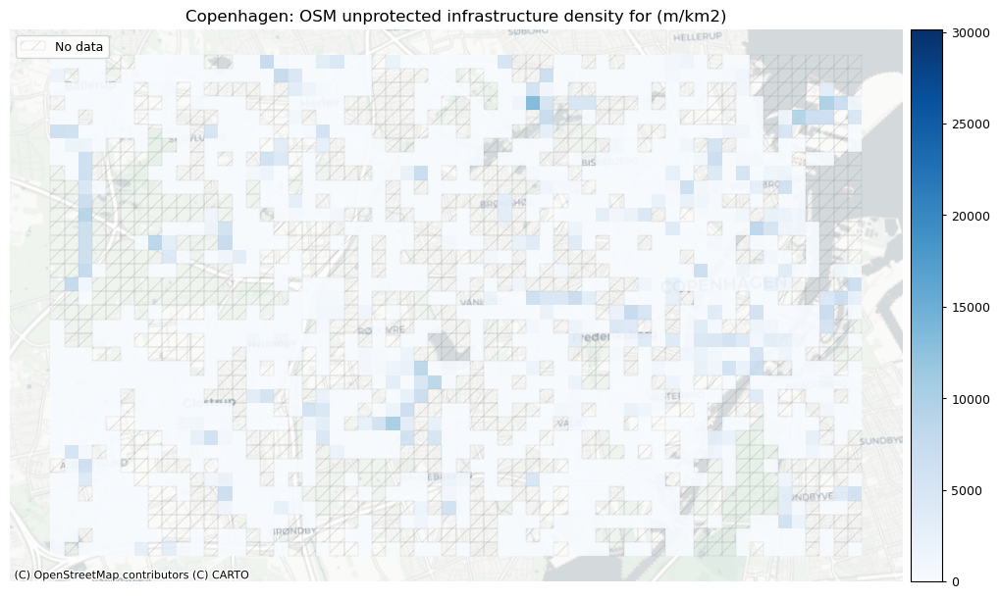

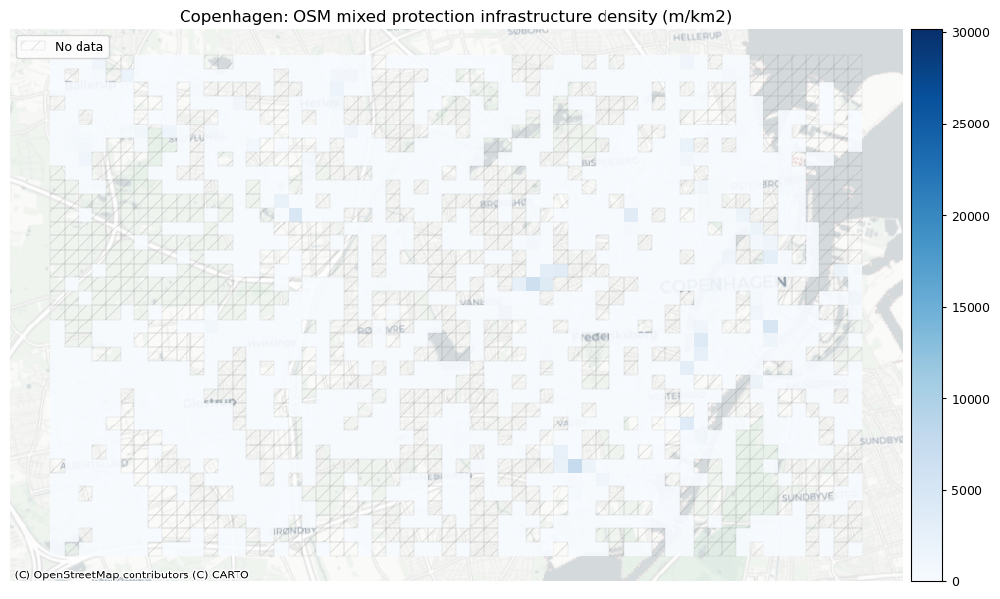

In [6]:
# Network density grid plots

set_renderer(renderer_map)
plot_cols = ["osm_protected_density", "osm_unprotected_density", "osm_mixed_density"]
plot_titles = [
    area_name+": OSM protected infrastructure density (m/km2)",
    area_name+": OSM unprotected infrastructure density for (m/km2)",
    area_name+": OSM mixed protection infrastructure density (m/km2)",
]
filepaths = [
    osm_results_static_maps_fp + "density_protected_osm",
    osm_results_static_maps_fp + "density_unprotected_osm",
    osm_results_static_maps_fp + "density_mixed_osm",
]

cmaps = [pdict["pos"]] * len(plot_cols)
no_data_cols = ["osm_protected_density", "osm_unprotected_density", "osm_mixed_density"]
norm_min = [0] * len(plot_cols)
norm_max = [max(grid[plot_cols].fillna(value=0).max())] * len(plot_cols)

plot_func.plot_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=plot_titles,
    filepaths=filepaths,
    cmaps=cmaps,
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=no_data_cols,
    use_norm=True,
    norm_min=norm_min,
    norm_max=norm_max,
)

## OSM标签分析

出于许多实际和研究目的，人们感兴趣的不仅仅是自行车基础设施的存在/不存在，还有更多的信息。 有关例如的信息 基础设施的宽度、速度限制、路灯等可能具有很高的相关性，例如在评估某个区域或单个网络段的自行车友好性时。 然而，这些描述自行车基础设施属性的标签在 OSM 中的分布非常不均匀，这对评估可骑自行车性和交通压力造成了障碍。 同样，对 OSM 特征标记方式缺乏限制有时会导致标记冲突，从而破坏循环条件的评估。

本节包括对缺失标签（带有缺乏信息的标签的边）、不兼容标签（带有两个或多个矛盾标签的标签的边）和标签模式（用于描述自行车基础设施的标签的空间变化）的分析。

对于标签的评估，应使用非简化边以避免在简化过程中聚合的标签出现问题。

### 缺少标签

需要或希望从 OSM 标签获取的信息取决于用例 - 例如，研究自行车道上的光照条件的项目的标签“lit”。 下面的工作流程允许快速分析具有可用于感兴趣标签的值的网络边缘的百分比。

**方法**

我们分析“config.yml”的“existing_tag_analysis”部分中定义的所有感兴趣的标签。 对于每个标签，“analyze_existing_tags”用于计算具有相应标签值的边的总数和百分比。

**解释**

在研究区域级别，现有标签值的百分比越高，原则上表明数据集的质量越高。 然而，这与现有标签值是否真实的估计不同。 在网格单元级别上，现有标签值的百分比低于平均水平可能表明映射的区域更差。 然而，对于边数较少的网格单元来说，百分比的信息量较少：例如，如果单元格包含一个具有“lit”标签值的单边，则现有标签值的百分比为 100% - 但考虑到这一点 只有 1 个数据点，这比包含 200 条边的单元格的 80% 值提供的信息要少。

<br />

<div class="alert alert-block alert-info">
<b>用户配置</b>
<br>
<br>
在OSM标签的分析中，用户设置用于：
<br>
<ul>
   <li>定义要分析缺失标签的标签 (<span style="font-family: monospace">missing_tag_analysis</span>) </li>
   <li>定义不兼容的标签值组合 (<span style="font-family: monospace">inknown_tags_analysis</span>) </li>
   <li>自行车基础设施标记的可视化（<span style="font-family: monospace">bicycle_infrastruct_queries</span>）</li>
</ul>
</div>

#### 全局缺失标签

In [7]:
print(f"Analysing tags describing:")
for k in existing_tag_dict.keys():
    print(k, "-", end=" ")
print("\n")

existing_tags_results = eval_func.analyze_existing_tags(osm_edges, existing_tag_dict)

for key, value in existing_tags_results.items():
    print(
        f"{key}: {value['count']} out of {len(osm_edges)} edges ({value['count']/len(osm_edges)*100:.2f}%) have information."
    )
    print(
        f"{key}: {round(value['length']/1000)} out of {round(osm_edges.geometry.length.sum()/1000)} km ({100*value['length']/osm_edges.geometry.length.sum():.2f}%) have information."
    )
    print("\n")

results_dict = {}
[
    eval_func.run_grid_analysis(
        grid_id,
        osm_edges_joined,
        results_dict,
        eval_func.analyze_existing_tags,
        existing_tag_dict,
    )
    for grid_id in grid_ids
]

# compute the length of osm edges in each grid cell to use for pct missing tags based on length
grid_feature_len = eval_func.length_features_in_grid(osm_edges_joined, "osm_edges")
grid = eval_func.merge_results(grid, grid_feature_len, "left")


restructured_results = {}

for key, value in results_dict.items():

    unpacked_results = {}

    for tag, _ in existing_tag_dict.items():

        unpacked_results[tag + "_count"] = value[tag]["count"]
        unpacked_results[tag + "_length"] = value[tag]["length"]

    restructured_results[key] = unpacked_results

results_df = pd.DataFrame.from_dict(restructured_results, orient="index")
cols = results_df.columns
new_cols = ["existing_tags_" + c for c in cols]
results_df.columns = new_cols
results_df["existing_tags_sum"] = results_df[new_cols].sum(axis=1)
results_df.reset_index(inplace=True)
results_df.rename(columns={"index": "grid_id"}, inplace=True)

grid = eval_func.merge_results(grid, results_df, "left")

for c in new_cols:
    if "count" in c:
        grid[c + "_pct"] = round(grid[c] / grid.count_osm_edges * 100, 2)
        grid[c + "_pct_missing"] = 100 - grid[c + "_pct"]

    elif "length" in c:
        grid[c + "_pct"] = round(grid[c] / grid.length_osm_edges * 100, 2)
        grid[c + "_pct_missing"] = 100 - grid[c + "_pct"]

existing_tags_pct = {}

existing_tags_pct = {}

for k, v in existing_tags_results.items():

    pct_dict = {}

    pct_dict["count_pct"] = (v["count"] / len(osm_edges)) * 100
    pct_dict["length_pct"] = (v["length"] / osm_edges.geometry.length.sum()) * 100

    existing_tags_pct[k] = pct_dict

for k, v in existing_tags_results.items():
    merged_results = v | existing_tags_pct[k]

    existing_tags_results[k] = merged_results

Analysing tags describing:
surface - width - speedlimit - lit - 

surface: 24821 out of 52168 edges (47.58%) have information.
surface: 575 out of 1290 km (44.62%) have information.


width: 6306 out of 52168 edges (12.09%) have information.
width: 111 out of 1290 km (8.57%) have information.


speedlimit: 25498 out of 52168 edges (48.88%) have information.
speedlimit: 673 out of 1290 km (52.16%) have information.


lit: 40759 out of 52168 edges (78.13%) have information.
lit: 1023 out of 1290 km (79.30%) have information.




In [8]:
# Save to csv

# Initialize lists with values for entire data set
edgecount_list = [len(osm_edges)]
kmcount_list = [round(osm_edges.geometry.length.sum() / 1000)]
keys_list = ["TOTAL"]

for key, value in existing_tags_results.items():
    keys_list.append(key)
    edgecount_list.append(value["count"])
    kmcount_list.append(round(value["length"] / 1000))

pd.DataFrame(
    {"tag": keys_list, "edge count": edgecount_list, "km (rounded)": kmcount_list}
).to_csv(osm_results_data_fp + "stats_tags.csv", index=False)

#### 本地缺失标签

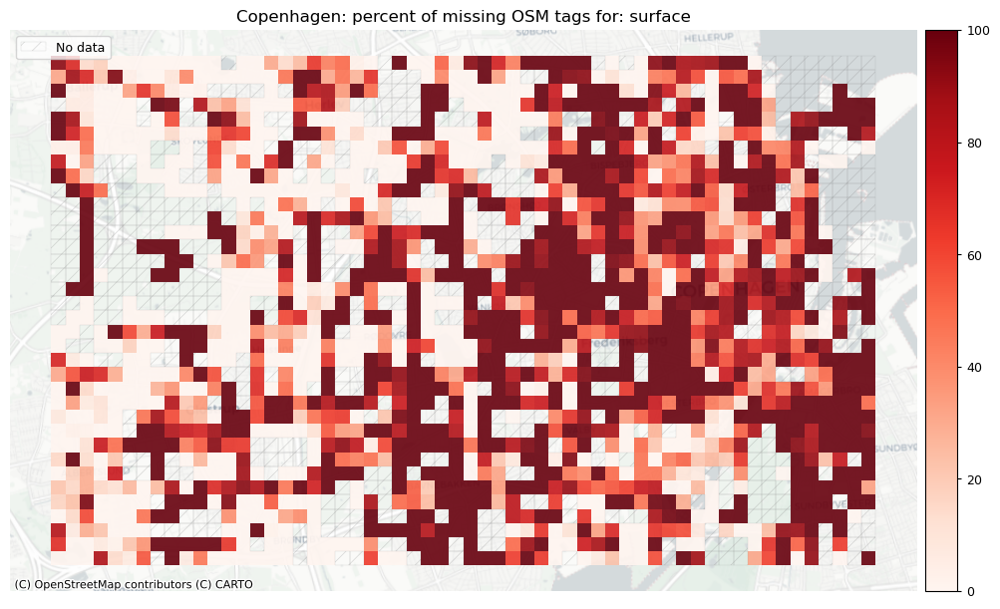

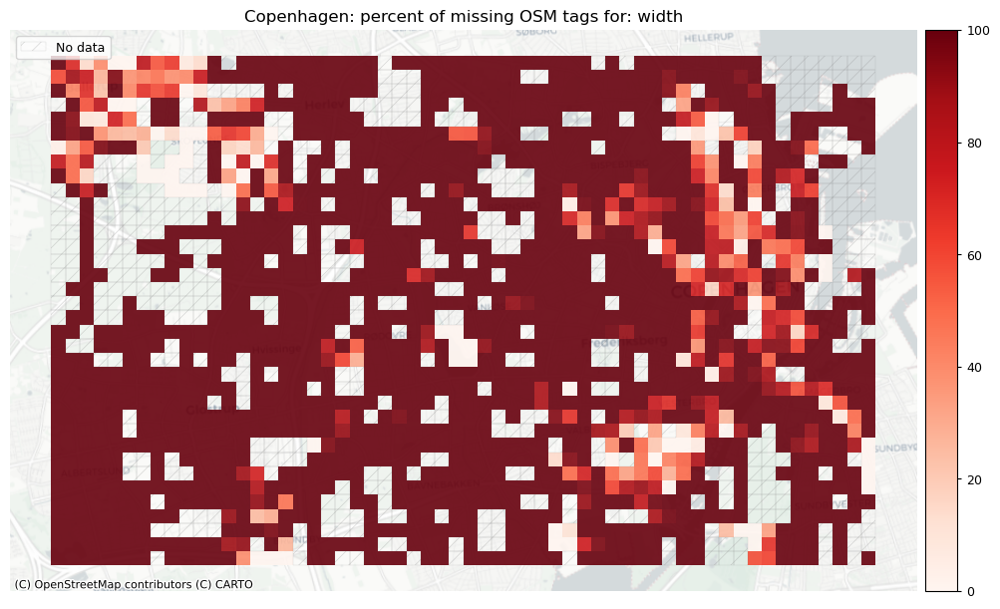

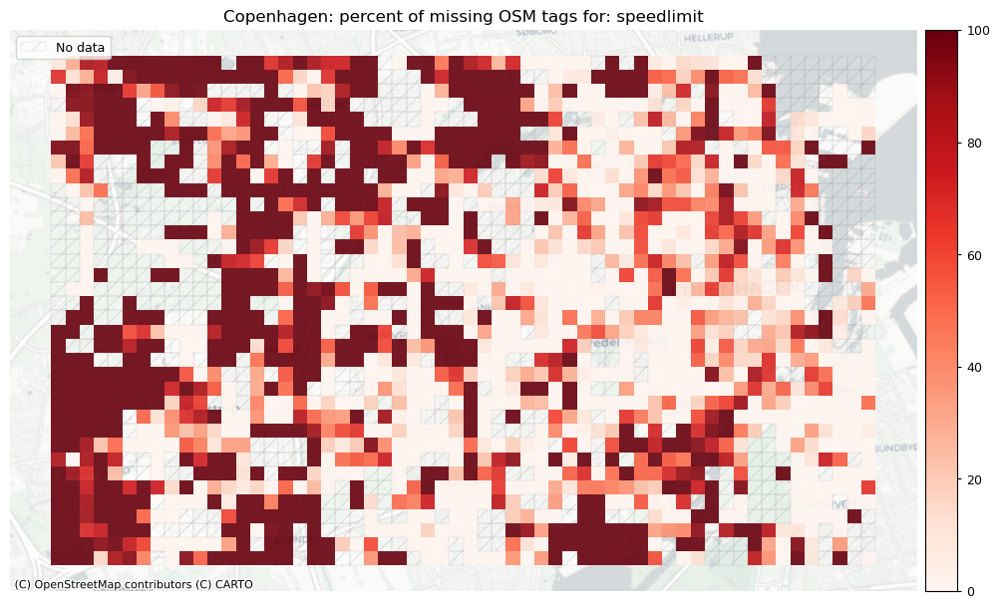

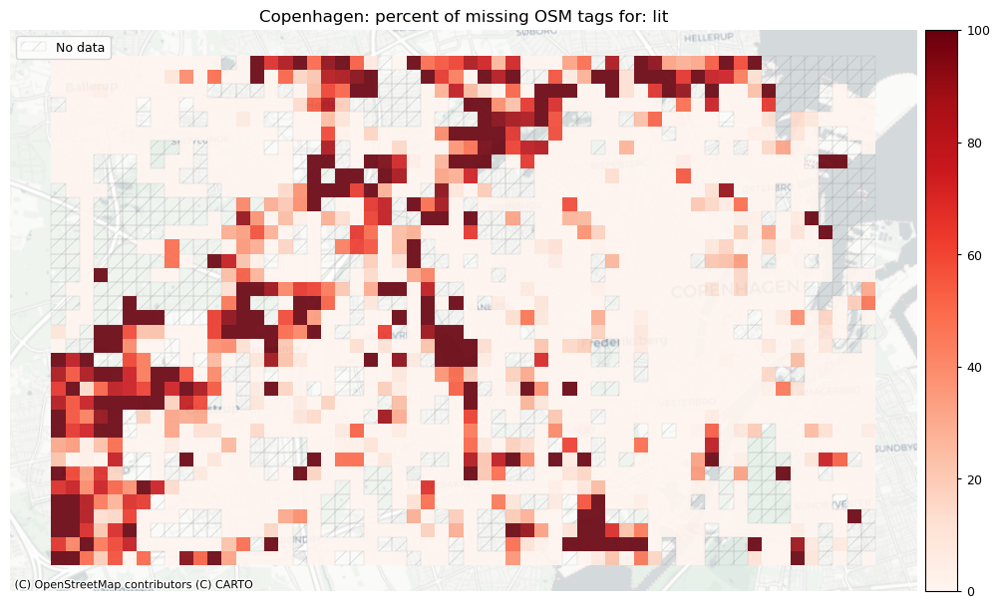

In [9]:
#  Plot pct missing for count

set_renderer(renderer_map)
count_cols = [c for c in cols if 'count' in c]
filepaths = [osm_results_static_maps_fp + "tagsmissing_" + c + '_osm' for c in count_cols]
plot_cols = ["existing_tags_" + c + "_pct_missing" for c in count_cols]
count_cols = [c.removesuffix('_count') for c in count_cols]
plot_titles = [area_name+": percent of missing OSM tags for: " + c for c in count_cols]

cmaps = [pdict["neg"]] * len(plot_cols)
no_data_cols = ["count_osm_edges"] * len(plot_cols)

plot_func.plot_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=plot_titles,
    filepaths=filepaths,
    cmaps=cmaps,
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=no_data_cols,
)

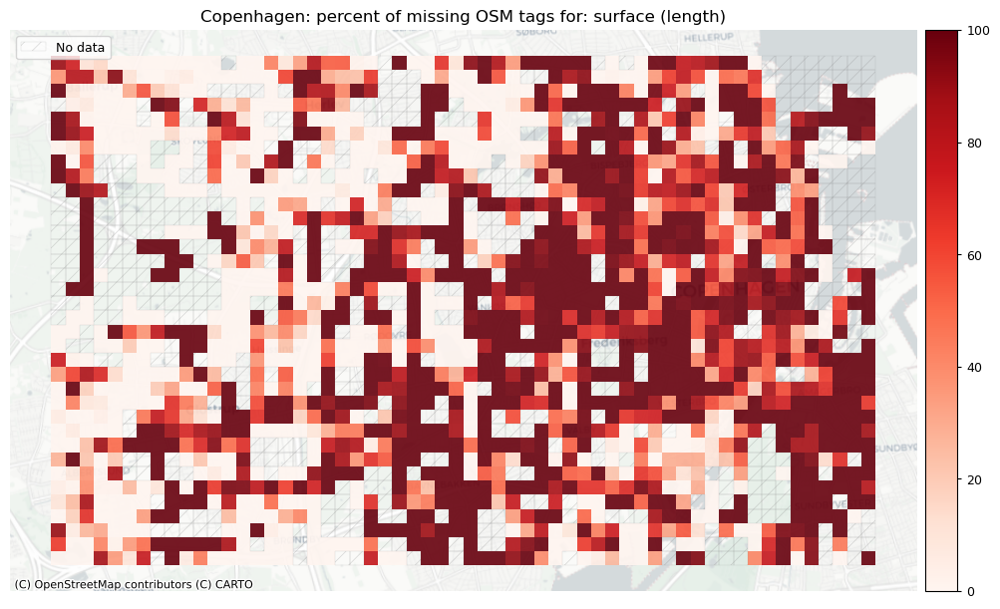

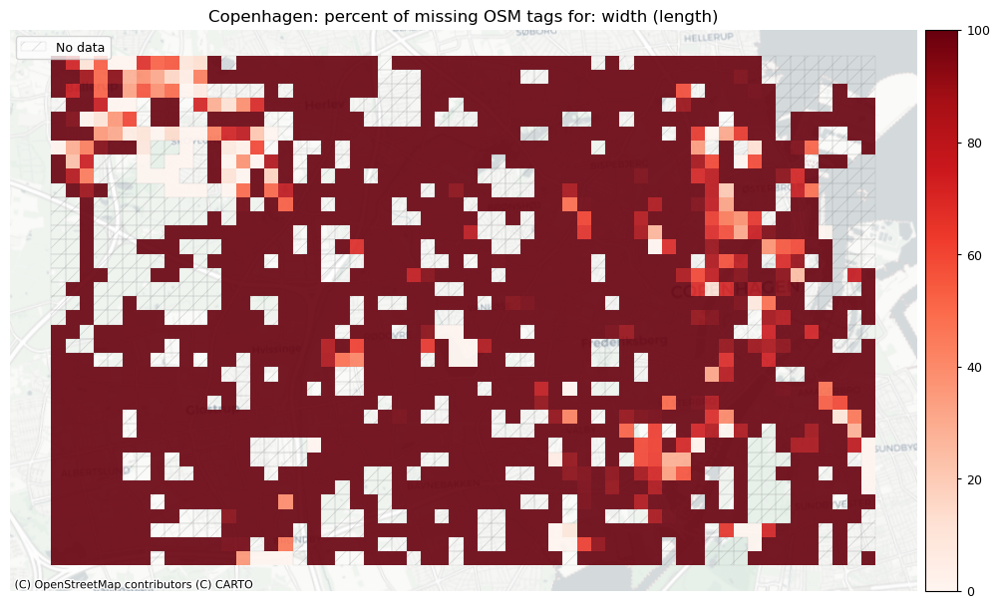

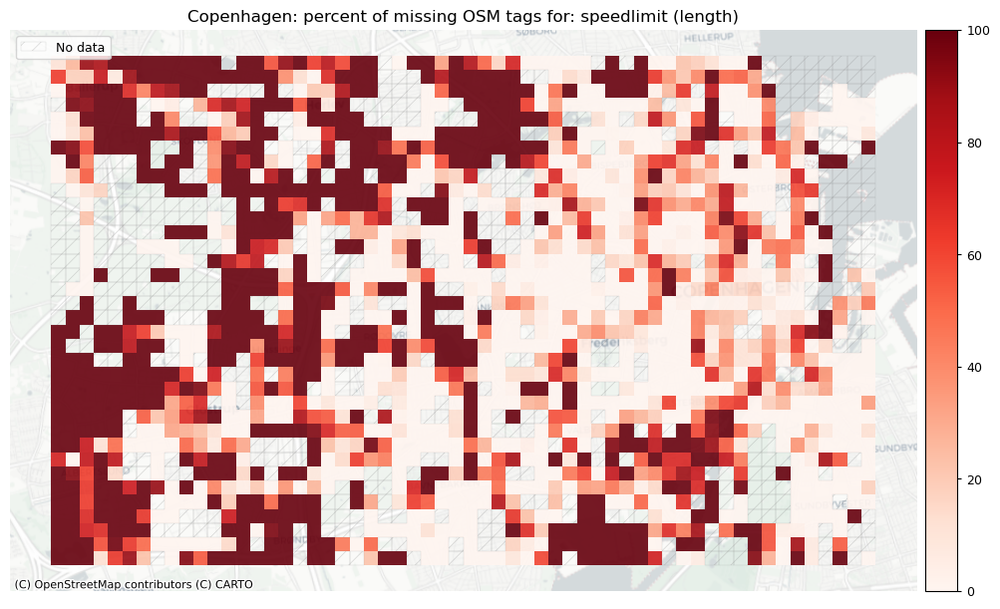

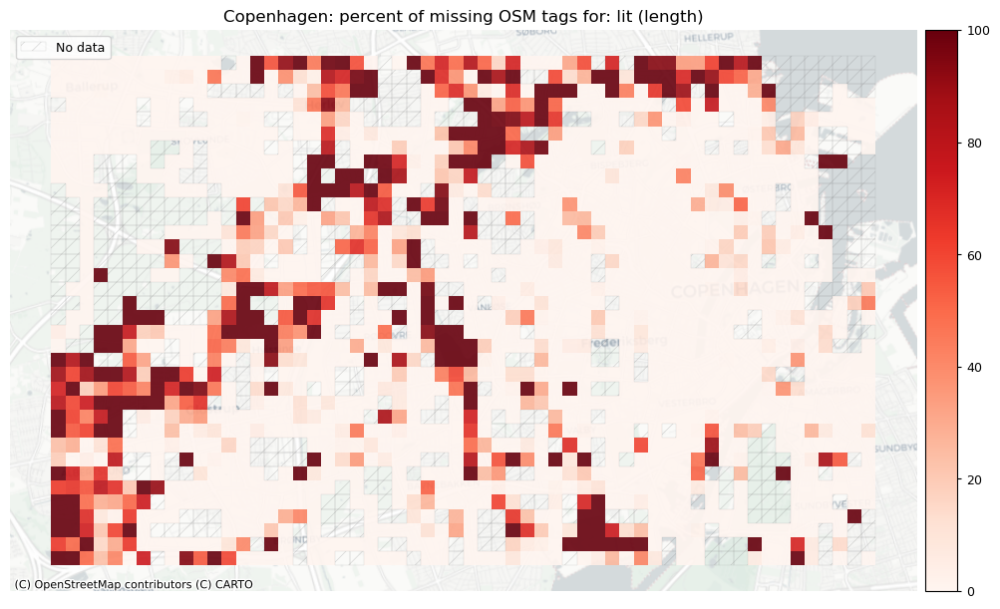

In [10]:
#  Plot pct missing based on the length of the edges with missing tags

set_renderer(renderer_map)
length_cols = [c for c in cols if 'length' in c]
plot_titles = [area_name+": percent of missing OSM tags for: " + c for c in length_cols]
filepaths = [osm_results_static_maps_fp + "tagsmissing_" + c + '_osm' for c in length_cols]
plot_cols = ["existing_tags_" + c + "_pct_missing" for c in length_cols]
plot_titles = [c.replace("_", " (") for c in plot_titles]
plot_titles = [c + ")" for c in plot_titles]

cmaps = [pdict["neg"]] * len(plot_cols)
no_data_cols = ["count_osm_edges"] * len(plot_cols)

plot_func.plot_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=plot_titles,
    filepaths=filepaths,
    cmaps=cmaps,
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=no_data_cols,
)

### 不兼容的标签

鉴于 OSM 数据中的标签有时缺乏一致性，并且标记过程没有限制（参见 [Barron et al., 2014](https://onlinelibrary.wiley.com/doi/10.1111/tgis.12073) ），数据集中可能存在不兼容的标签。 例如，一条边可能被标记为以下两个相互矛盾的键值对：“bicycle_infrastruct = yes”和“bicycle = no”。

**方法**

在“config.yml”文件中，定义了“incomplete_tags_analysis”中标签的不兼容键值对列表。 由于数据集可能包含的标签没有限制，因此根据定义，该列表并不详尽，并且可以由用户进行调整。 在下面的部分中，运行“check_inknown_tags”，它首先在研究区域级别上，然后在网格单元级别上识别给定区域的所有不兼容实例。

**解释**

不兼容的标签是数据集的一个不受欢迎的特征，并使相应的数据点无效； 没有直接的方法可以自动解决出现的问题，因此必须手动更正标签或从数据集中排除数据点。 网格单元中不兼容标签的数量高于平均水平表明存在局部映射问题。

#### 全局不兼容标签（总数）

In [11]:
incompatible_tags_results = eval_func.check_incompatible_tags(
    osm_edges, incompatible_tags_dict, store_edge_ids=True
)

print(
    f"In the entire data set, there are {sum(len(lst) for lst in incompatible_tags_results.values())} incompatible tag combinations (of those defined in the configuration file)."
)

results_dict = {}
[
    eval_func.run_grid_analysis(
        grid_id,
        osm_edges_joined,
        results_dict,
        eval_func.check_incompatible_tags,
        incompatible_tags_dict,
    )
    for grid_id in grid_ids
]

results_df = pd.DataFrame(
    index=results_dict.keys(), columns=results_dict[list(results_dict.keys())[0]].keys()
)

for i in results_df.index:
    for j in results_df.columns:
        results_df.at[i, j] = results_dict[i][j]

cols = results_df.columns
new_cols = ["incompatible_tags_" + c for c in cols]
results_df.columns = new_cols
results_df["incompatible_tags_sum"] = results_df[new_cols].sum(axis=1)
results_df.reset_index(inplace=True)
results_df.rename(columns={"index": "grid_id"}, inplace=True)
grid = eval_func.merge_results(grid, results_df, "left")

In the entire data set, there are 2 incompatible tag combinations (of those defined in the configuration file).


In [12]:
# Save to csv
df = pd.DataFrame(
    index=incompatible_tags_results.keys(), data=incompatible_tags_results.values()
)
edge_ids = []
for index, row in df.iterrows():
    edge_ids.append(row.to_list())

df["edge_id"] = edge_ids
incomp_df = df[["edge_id"]]

incomp_df.to_csv(osm_results_data_fp + "incompatible_tags.csv", index=True)

#### 本地不兼容标签（每个网格单元）

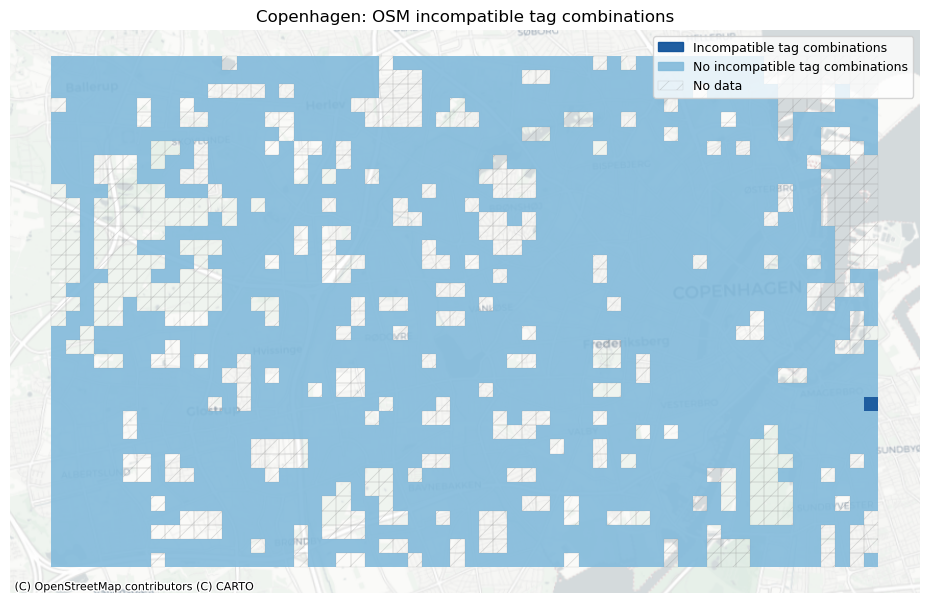

In [13]:
# Overview plots (grid)

if len(new_cols) > 0:

    set_renderer(renderer_map)
    fig, ax = plt.subplots(1, figsize=pdict["fsmap"])

    grid.loc[grid.incompatible_tags_sum == 0].plot(
        ax=ax, alpha=pdict["alpha_grid"], color=mpl.colors.rgb2hex(incompatible_false_patch.get_facecolor())
    )
    grid.loc[grid.incompatible_tags_sum > 0].plot(
        ax=ax, alpha=pdict["alpha_grid"], color=mpl.colors.rgb2hex(incompatible_true_patch.get_facecolor())
    )

    # add no data patches
    grid[grid["count_osm_edges"].isnull()].plot(
        ax=ax,
        facecolor=pdict["nodata_face"],
        edgecolor=pdict["nodata_edge"],
        linewidth= pdict["line_nodata"],
        hatch=pdict["nodata_hatch"],
        alpha=pdict["alpha_nodata"],
    )

    ax.legend(
        handles=[incompatible_true_patch, incompatible_false_patch, nodata_patch],
        loc="upper right",
    )

    ax.set_title(area_name+": OSM incompatible tag combinations")
    ax.set_axis_off()
    cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)

    plot_func.save_fig(fig, osm_results_static_maps_fp + "tagsincompatible_osm")

else:
    print("There are no incompatible tag combinations to plot.")

#### 绘制不兼容的标签几何形状

In [14]:
incompatible_tags_edge_ids = eval_func.check_incompatible_tags(
    osm_edges, incompatible_tags_dict, store_edge_ids=True
)

if len(incompatible_tags_edge_ids) > 0:

    incompatible_tags_fg = []

    # iterate through dict of queries,
    for i, key in enumerate(list(incompatible_tags_edge_ids.keys())):
        # create one feature group for each query
        # and append it to list
        incompatible_tags_fg.append(
            plot_func.make_edgefeaturegroup(
                gdf=osm_edges[
                    osm_edges["edge_id"].isin(incompatible_tags_edge_ids[key])
                ],
                mycolor=pdict["basecols"][i],
                myweight=pdict["line_emp"],
                nametag="Incompatible tags: " + key,
                show_edges=True,
            )
        )

    ### Make marker feature group
    edge_ids = [
        item
        for sublist in list(incompatible_tags_edge_ids.values())
        for item in sublist
    ]  # get ids of all edges that have incompatible tags

    mfg = plot_func.make_markerfeaturegroup(
        osm_edges.loc[osm_edges["edge_id"].isin(edge_ids)], nametag="Incompatible tag marker", show_markers=True
    )
    incompatible_tags_fg.append(mfg)

    # create interactive map
    m = plot_func.make_foliumplot(
        feature_groups=incompatible_tags_fg,
        layers_dict=folium_layers,
        center_gdf=osm_nodes,
        center_crs=osm_nodes.crs,
    )

    bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
    m.fit_bounds(bounds)

    m.save(osm_results_inter_maps_fp + "tagsincompatible_osm.html")

    display(m)

In [15]:
if len(incompatible_tags_edge_ids) > 0:
    print("Interactive map saved at " + osm_results_inter_maps_fp.lstrip("../") + "tagsincompatible_osm.html")
else:
    print("There are no incompatible tag combinations to plot.")

Interactive map saved at results/OSM/cph_geodk/maps_interactive/tagsincompatible_osm.html


### 标记模式

由于可以通过多种不同的方式来指示自行车基础设施的存在，因此在 OSM 中识别自行车基础设施可能很棘手。 [OSM Wiki](https://wiki.openstreetmap.org/wiki/Main_Page) 是一个很好的资源，提供了有关如何标记 OSM 功能的建议，但可能仍然存在一些不一致和局部变化。 对标记模式的分析可以直观地探索一些潜在的不一致之处。

无论自行车基础设施是如何定义的，检查哪些标签对自行车网络的哪些部分有贡献，都可以直观地检查标签方法中的模式。 它还允许估计查询的某些元素是否会导致包含太多或太少的特征。

同样，使用多个不同标签来指示自行车基础设施的“双重标签”可能会导致数据错误分类。 因此，识别包含在多个定义自行车基础设施的查询中的特征可以表明标记质量存在问题。

**方法**

我们首先为“bicycle_infrastruction_queries”中列出的每个查询绘制 OSM 数据集的各个子集，如“config.yml”文件中所定义。 查询定义的子集是该查询为*True*的边的集合。 由于多个查询对于同一条边可能是“True”，因此子集可能会重叠。 在下面的第二步中，绘制两个或多个查询之间的所有重叠，即已分配多个可能竞争的标签的所有边。

**解释**

每种标记类型的图可以快速直观地概览该区域中存在的不同标记模式。 基于本地知识，用户可以估计标记类型的差异是由于基础设施中的实际物理差异还是OSM数据的人为造成的。 接下来，用户可以访问不同标签之间的重叠部分； 根据具体标签，这可能是也可能不是数据质量问题。 例如，在“cycleway:right”和“cycleway:left”的情况下，两个标签的数据都是有效的，但其他组合如“cycleway”=“track”和“cycleway:left” =lane'` 给出了关于自行车基础设施类型的模糊描述。

#### 标记类型

In [16]:
osm_edges["tagging_type"] = ""

for k, q in bicycle_infrastructure_queries.items():

    try:
        ox_filtered = osm_edges.query(q)

    except Exception:
        print("Exception occured when quering with:", q)

    osm_edges.loc[ox_filtered.index, "tagging_type"] = (
        osm_edges.loc[ox_filtered.index, "tagging_type"] + k
    )

In [17]:
# Interactive plot of tagging types

# initialize list of folium feature groups (one per tagging type)
tagging_types_fg = []

# iterate through dict of queries,
i = 0  # index for color change
for key in bicycle_infrastructure_queries.keys():
    # create one feature group for each query
    # and append it to list
    tagging_types_fg.append(
        plot_func.make_edgefeaturegroup(
            gdf=osm_edges[osm_edges["tagging_type"] == key],
            mycolor=pdict["basecols"][i],
            myweight=2,
            nametag="Tagging type " + key,
            show_edges=True,
        )
    )
    i += 1  # update index

# create interactive map
m = plot_func.make_foliumplot(
    feature_groups=tagging_types_fg,
    layers_dict=folium_layers,
    center_gdf=osm_nodes_simplified,
    center_crs=osm_nodes_simplified.crs,
)

bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
m.fit_bounds(bounds)

m.save(osm_results_inter_maps_fp + "taggingtypes_osm.html")

for k, v in bicycle_infrastructure_queries.items():
    print("Tagging type " + k + ": " + v)

display(m)

Tagging type A: highway == 'cycleway'
Tagging type B: cycleway in ['lane','track','opposite_lane','opposite_track','designated','crossing']
Tagging type C: cycleway_left in ['lane','track','opposite_lane','opposite_track','designated','crossing']
Tagging type D: cycleway_right in ['lane','track','opposite_lane','opposite_track','designated','crossing']
Tagging type E: cycleway_both in ['lane','track','opposite_lane','opposite_track','designated','crossing']


In [18]:
print("Interactive map saved at " + osm_results_inter_maps_fp.lstrip("../") + "taggingtypes_osm.html")

Interactive map saved at results/OSM/cph_geodk/maps_interactive/taggingtypes_osm.html


#### 多重标记

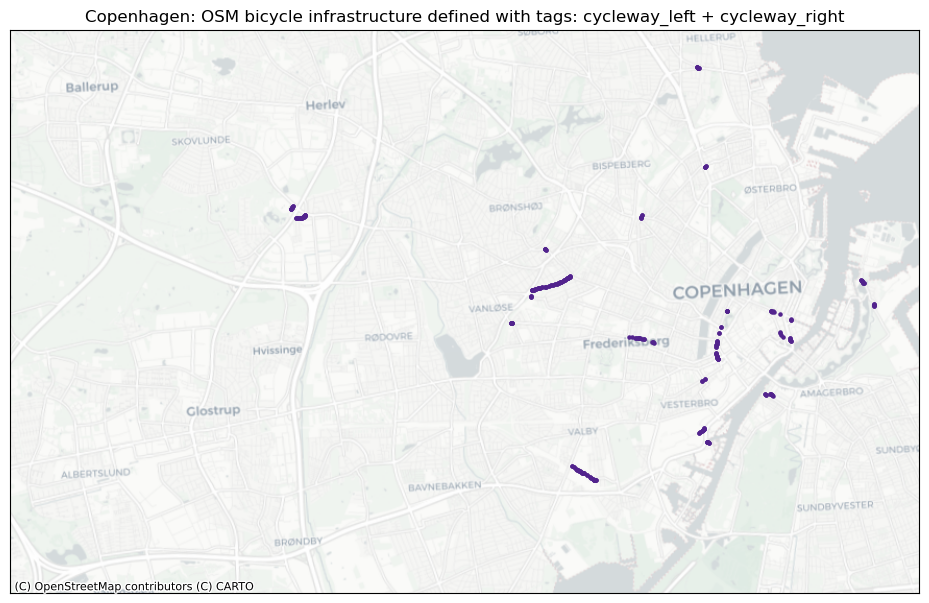

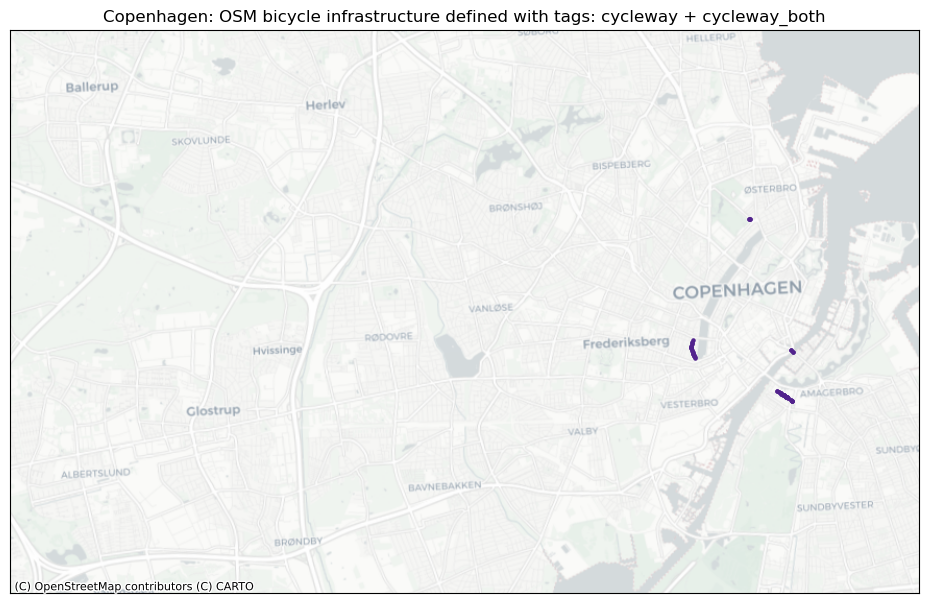

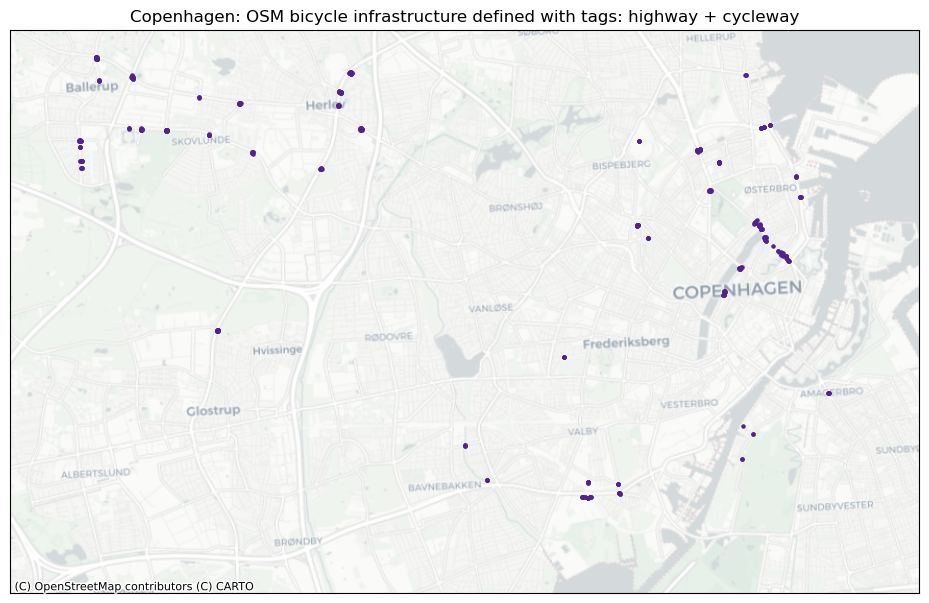

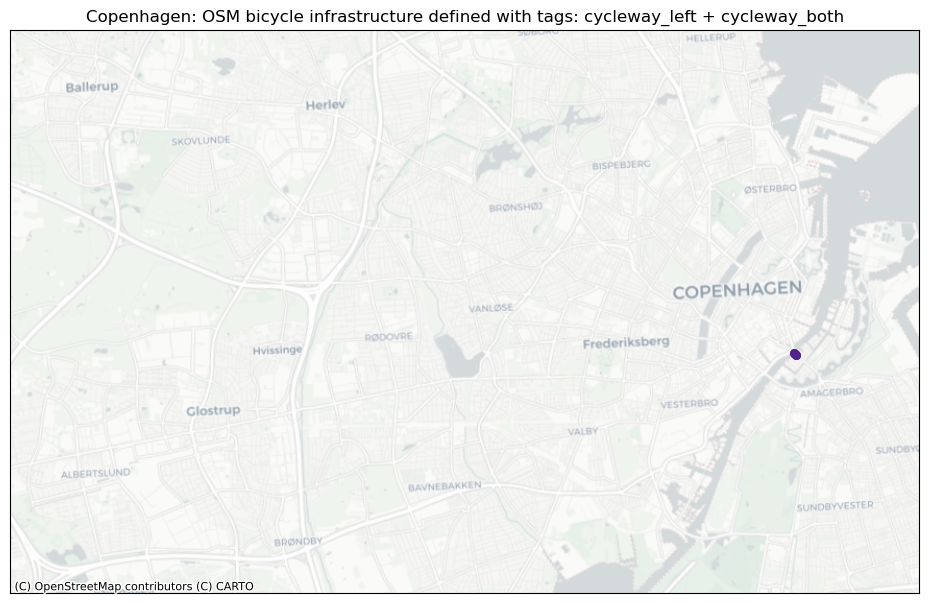

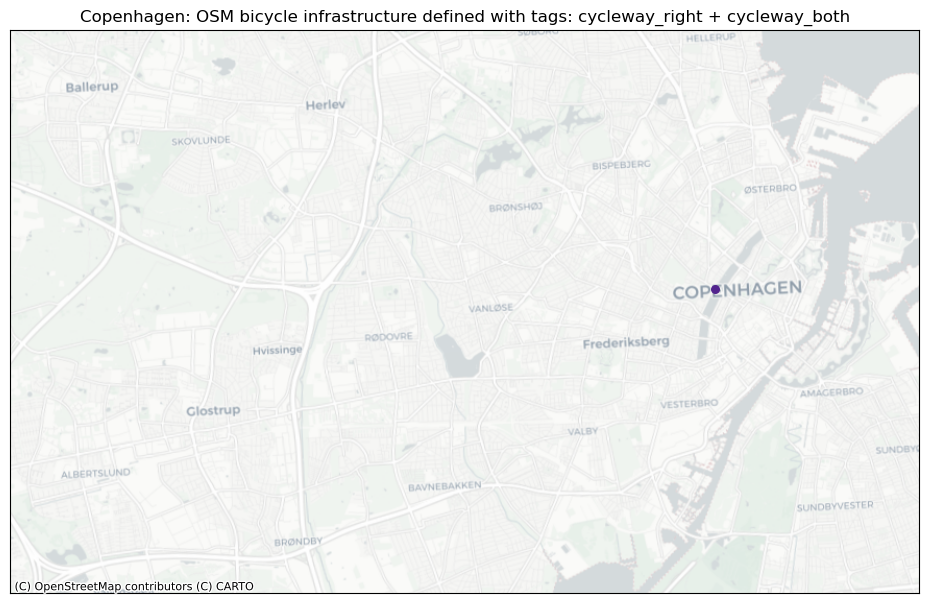

In [19]:
# Plot all osm_edges which are returned for more than one tagging_type

set_renderer(renderer_map)
tagging_combinations = list(osm_edges.tagging_type.unique())
tagging_combinations = [x for x in tagging_combinations if len(x) > 1]

if len(tagging_combinations) > 0:

    for i, t in enumerate(tagging_combinations):

        fig, ax = plt.subplots(1, figsize=pdict["fsmap"])

        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        if len(osm_edges.loc[osm_edges["tagging_type"] == t]) < 10:

            grid.plot(ax=ax, facecolor="none", edgecolor="none", alpha=0)
            osm_edges.loc[osm_edges["tagging_type"] == t]["geometry"].centroid.plot(
                ax=ax, color=pdict["osm_emp"], markersize=30
            )

        else:
            grid.plot(ax=ax, facecolor="none", edgecolor="none", alpha=0)
            osm_edges.loc[osm_edges["tagging_type"] == t]["geometry"].centroid.plot(
                ax=ax, color=pdict["osm_emp"], markersize=5
            )


        columns_in_query = ""
        for value in t:
            tag_name = bicycle_infrastructure_queries[value].split(" ")[0]
            columns_in_query = columns_in_query + tag_name + " + "

        columns_in_query = columns_in_query[:-3]

        title = area_name+": OSM bicycle infrastructure defined with tags: " + columns_in_query

        ax.set_title(title)

        cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)

        filepath_extension = columns_in_query.replace(" + ", "-")
        
        plot_func.save_fig(fig, osm_results_static_maps_fp + f"tagscompeting_{filepath_extension}_osm")

    plt.show()

In [20]:
if len(tagging_combinations) > 0:

    # set seed for colors
    np.random.seed(42)

    # generate enough random colors to plot all tagging combinations
    randcols = [colors.to_hex(rgbcol) for rgbcol in np.random.rand(len(tagging_combinations), 3)]

    # initialize list of feature groups (one for each tagging combination)
    tag_featuregroups = []
    
    for i, t in enumerate(tagging_combinations):

        columns_in_query = ""

        for value in t:
            tag_name = bicycle_infrastructure_queries[value].split(" ")[0]
            columns_in_query = columns_in_query + tag_name + " + "

        columns_in_query = columns_in_query[:-3]

        tag_featuregroup = plot_func.make_edgefeaturegroup(
            gdf=osm_edges.loc[osm_edges["tagging_type"] == t],
            mycolor=randcols[i],
            myweight=pdict["line_emp"],
            nametag=columns_in_query,
            show_edges=True,
        )

        tag_featuregroups.append(tag_featuregroup)

        
    m = plot_func.make_foliumplot(
        feature_groups=tag_featuregroups,
        layers_dict=folium_layers,
        center_gdf=osm_nodes_simplified,
        center_crs=osm_nodes_simplified.crs,
    )

    bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
    m.fit_bounds(bounds)

    m.save(osm_results_inter_maps_fp + "taggingcombinations_osm.html") 

    display(m)

In [21]:
if len(tagging_combinations) > 0:
    print("Interactive map saved at " + osm_results_inter_maps_fp.lstrip("../") + "taggingcombinations_osm.html")
else:
    print("There are no tagging combinations to plot.")

Interactive map saved at results/OSM/cph_geodk/maps_interactive/taggingcombinations_osm.html


## 网络拓扑结构

本节探讨数据的几何和拓扑特征。 例如，这些是网络密度、断开的组件和悬空（一级）节点。 它还包括探索是否存在彼此非常接近但不共享边缘的节点（边缘下冲的潜在迹象），或者是否存在相交边缘而在相交处没有节点，这可能表明存在数字化错误，该错误将导致数字化错误。 扭曲网络上的路由。

由于大多数自行车网络的分散性，许多指标（例如缺失链接或网络间隙）可以简单地反映基础设施的真实范围([Natera Orozco et al., 2020](https://onlinelibrary.wiley.com/doi/pdfdirect/10.1111/gean.12324))。 这对于道路网络来说是不同的，例如，断开的组件更容易被解释为数据质量问题。 因此，分析仅将非常小的网络间隙视为潜在的数据质量问题。

### 简化结果

为了比较网络中节点和边之间的结构和真实比率，通过删除所有间隙节点，在笔记本“1a”中创建了仅包括端点和交叉点处的节点的简化网络表示。

比较简化前后网络的度分布是对简化例程的快速健全性检查。 通常，非简化网络中的绝大多数节点都是二级节点； 然而，在简化的网络中，大多数节点的度数不是二。 仅在两种情况下保留二级节点：如果它们代表两种不同类型的基础设施之间的连接点； 或者如果需要它们以避免自环（起点和终点相同的边）或同一对节点之间的多个边。

<p align="center">
<img src='../../images/network_simplification_illustration.png' width=300/>

*非简化网络（左）和简化网络（右）*。

</p>

**方法**

简化前后的度分布如下图所示。

**解释**

通常，度分布将从高（简化前）到低（简化后）二度节点计数，而对于所有其他度（1 或 3 及更高），它不会改变。 此外，节点总数将出现大幅下降。 如果简化后的图仍然保持相对较高的二度节点数量，或者简化后具有其他度数的节点数量发生变化，则这可能表明图转换或简化过程存在问题。

In [22]:
# Decrease in network elements after simplification

edge_percent_diff = (len(osm_edges) - len(osm_edges_simplified)) / len(osm_edges) * 100
node_percent_diff = (len(osm_nodes) - len(osm_nodes_simplified)) / len(osm_nodes) * 100

simplification_results = {
    "edge_percent_diff": edge_percent_diff,
    "node_percent_diff": node_percent_diff,
}

print(
    f"Simplifying the network decreased the number of edges by {edge_percent_diff:.1f}% and the number of nodes by {node_percent_diff:.1f}%."
)

Simplifying the network decreased the number of edges by 89.0% and the number of nodes by 84.4%.


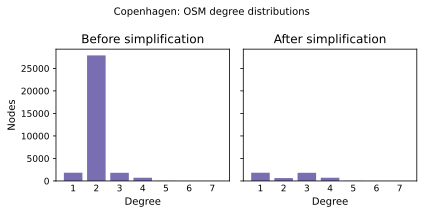

In [23]:
# Degree distribution

set_renderer(renderer_plot)
fig, ax = plt.subplots(1, 2, figsize=pdict["fsbar_short"], sharey=True)

degree_sequence_before = sorted((d for n, d in osm_graph.degree()), reverse=True)
degree_sequence_after = sorted(
    (d for n, d in osm_graph_simplified.degree()), reverse=True
)

# Plot degree distributions
ax[0].bar(*np.unique(degree_sequence_before, return_counts=True), tick_label = np.unique(degree_sequence_before), color=pdict["osm_base"])
ax[0].set_title("Before simplification")
ax[0].set_xlabel("Degree")
ax[0].set_ylabel("Nodes")

ax[1].bar(*np.unique(degree_sequence_after, return_counts=True), tick_label = np.unique(degree_sequence_after), color=pdict["osm_base"])
ax[1].set_title("After simplification")
ax[1].set_xlabel("Degree")

plt.suptitle(f"{area_name}: OSM degree distributions")

fig.tight_layout()

plot_func.save_fig(fig, osm_results_plots_fp + "degree_dist_osm")

plt.show();

### 悬空节点

悬空节点是一阶节点，即它们仅附有一条边。 大多数网络自然会包含许多悬空节点。 悬空节点可能出现在实际的死胡同（代表死胡同）或某些特征的端点处，例如 当自行车道在街道中间结束时。 但是，在出现过冲/下冲的情况下，悬空节点也可能会作为数据质量问题出现（请参阅下一节）。 网络中悬空节点的数量在某种程度上也取决于数字化方法，如下图所示。

因此，悬空节点的存在本身并不是数据质量低的标志。 然而，在未知包含许多死胡同的区域中存在大量悬空节点可能表明数字化错误和边缘上冲/下冲问题。

<!-- <table><tr><td><img src='../../images/dangling_nodes_illustration.png' width=300 /></td><td><img src='../ ../images/no_dangling_nodes_illustration.png' width=295 /></td></tr></table>

*左：悬挂节点出现在道路要素结束处。 右：但是，当最后连接单独的特征时，将不会有悬空节点。* -->

<p align="center">

<img src='../../images/dangling_nodes_illustration_new.png' width=350/>

*左：悬挂节点出现在道路要素结束处。 右：但是，当最后连接单独的特征时，将不会有悬空节点。*

</p>

**方法**

下面，在“get_dangling_nodes”的帮助下获得了所有悬空节点的列表。 然后，绘制包含所有节点的网络。 悬空节点以颜色显示，所有其他节点以黑色显示。

**解释**

我们建议进行可视化分析，以解释悬挂节点的空间分布，特别注意悬挂节点密度高的区域。 重要的是要了解悬挂节点的来源：它们是真正的死胡同还是数字化错误（例如，过冲/下冲）？ 数字化错误数量越多表明数据质量越低。

<br/>

In [24]:
# Compute number of dangling nodes
dangling_nodes = eval_func.get_dangling_nodes(
    osm_edges_simplified, osm_nodes_simplified
)

# Export results
dangling_nodes.to_file(osm_results_data_fp + "dangling_nodes.gpkg", index=False)

# Compute local count and pct of dangling nodes
dn_osm_joined = gpd.overlay(
    dangling_nodes, grid[["geometry", "grid_id"]], how="intersection"
)
df = eval_func.count_features_in_grid(dn_osm_joined, "osm_dangling_nodes")
grid = eval_func.merge_results(grid, df, "left")

grid["osm_dangling_nodes_pct"] = np.round(
    100 * grid.count_osm_dangling_nodes / grid.count_osm_simplified_nodes, 2
)

# set to zero where there are simplified nodes but no dangling nodes
grid["osm_dangling_nodes_pct"].loc[
    grid.count_osm_simplified_nodes.notnull() & grid.osm_dangling_nodes_pct.isnull()
] = 0

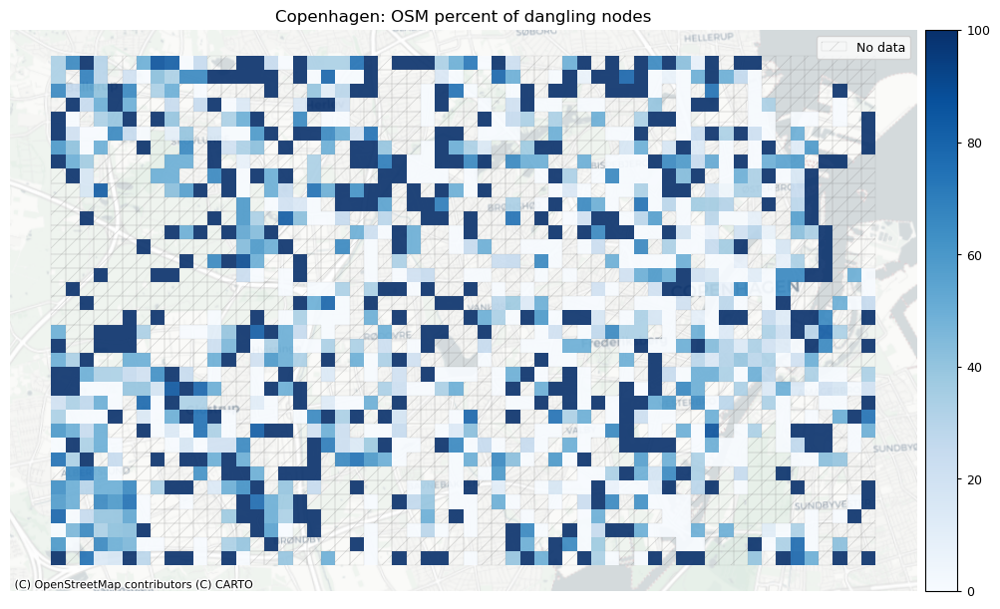

In [25]:
# Plot dangling nodes

set_renderer(renderer_map)
fig, ax = plt.subplots(1, figsize=pdict["fsmap"])

from mpl_toolkits.axes_grid1 import make_axes_locatable
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="3.5%", pad="1%")

grid.plot(
    cax=cax,
    column="osm_dangling_nodes_pct",
    ax=ax,
    alpha=pdict["alpha_grid"],
    cmap=pdict["pos"],
    legend=True,
)

# add no data patches
grid[grid["count_osm_simplified_nodes"].isnull()].plot(
    cax=cax,
    ax=ax,
    facecolor=pdict["nodata_face"],
    edgecolor=pdict["nodata_edge"],
    linewidth= pdict["line_nodata"],
    hatch=pdict["nodata_hatch"],
    alpha=pdict["alpha_nodata"],
)

ax.legend(handles=[nodata_patch], loc="upper right")
ax.set_title(f"{area_name}: OSM percent of dangling nodes")
ax.set_axis_off()
cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)

plot_func.save_fig(fig, osm_results_static_maps_fp + "pct_dangling_nodes_osm")

In [26]:
# Interactive plot of dangling nodes

edges_simplified_folium = plot_func.make_edgefeaturegroup(
    gdf=osm_edges_simplified,
    mycolor=pdict["base"],
    myweight=pdict["line_base"],
    nametag="Edges",
    show_edges=True,
)

nodes_simplified_folium = plot_func.make_nodefeaturegroup(
    gdf=osm_nodes_simplified,
    mysize=pdict["mark_base"],
    mycolor=pdict["base"],
    nametag="All nodes",
    show_nodes=True,
)

dangling_nodes_folium = plot_func.make_nodefeaturegroup(
    gdf=dangling_nodes,
    mysize=pdict["mark_emp"],
    mycolor= pdict["osm_base"],
    nametag="Dangling nodes",
    show_nodes=True,
)

m = plot_func.make_foliumplot(
    feature_groups=[
        edges_simplified_folium,
        nodes_simplified_folium,
        dangling_nodes_folium,
    ],
    layers_dict=folium_layers,
    center_gdf=osm_nodes_simplified,
    center_crs=osm_nodes_simplified.crs,
)

bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
m.fit_bounds(bounds)

m.save(osm_results_inter_maps_fp + "danglingmap_osm.html")

display(m)

In [27]:
print("Interactive map saved at " + osm_results_inter_maps_fp.lstrip("../") + "danglingmap_osm.html")

Interactive map saved at results/OSM/cph_geodk/maps_interactive/danglingmap_osm.html


### 下冲/过冲

当简化网络中的两个节点放置在几米距离内但不共享公共边缘时，通常是由于边缘上冲/下冲或其他数字化错误造成的。 当两个特征应该相交，但实际上彼此非常接近时，就会发生下冲。 当两个特征相遇并且其中一个特征超出另一个特征时，就会发生超调。 请参见下图的说明。 有关过冲/下冲的更详细说明，请参阅 [GIS Lounge 网站](https://www.gislounge.com/digitizing-errors-in-gis/)。

<p align="center">

<img src='../../images/over_undershoots2.png' width=350/>

*左：当两条线要素未正确连接时（例如在交叉点处），会发生下冲。 右图：过冲是指线要素在相交线处延伸太远，而不是在相交处结束的情况。*

</p>


**方法**

*下冲：*首先，“length_tolerance”（以米为单位）在下面的单元格中定义。 然后，使用“find_undershoots”，所有之间距离最大为“length_tolerance”的悬空节点对都被识别为下冲，并绘制结果。

*超调：*首先，“长度公差”（以米为单位）在下面的单元格中定义。 然后，使用“find_overshoots”，所有连接有悬空节点且最大长度为“length_tolerance”的网络边都被识别为过冲，并绘制结果。

过冲/下冲检测方法的灵感来自于 [Neis et al. (2012)](https://www.mdpi.com/1999-5903/4/1/1)。

**解释**

欠调/过调不一定总是数据质量问题 - 它们可能是网络状况或数字化策略的准确表示。 例如，自行车道可能在转弯后不久突然结束，从而导致超调。 受保护的自行车道有时会在 OSM 中数字化，因为在交叉口处中断，从而导致交叉口下冲。

过冲/下冲对数据质量影响的解释取决于上下文。 对于某些应用，例如路由，过冲并不构成特殊的挑战； 然而，鉴于它们扭曲了网络结构，它们可能会给网络分析等其他应用带来问题。 相反，下冲对于路线应用来说是一个严重的问题，特别是如果只考虑自行车基础设施的话。 它们还给网络分析带来了问题，例如对于任何基于路径的度量，例如大多数中心性度量，如介数中心性。

<br />

<div class="alert alert-block alert-info">
<b>User configurations</b>
<br>
<br>
在分析过冲和下冲时，用户可以修改过冲和下冲的长度公差。 <br>
例如，过冲的长度容差为 3 米，这意味着只有长度为 3 米或更小的边缘片段才被视为过冲。<br>
下冲容差为 5 米，意味着只有 5 米或更小的间隙才被视为下冲。
</div>

In [28]:
# USER INPUT: LENGTH TOLERANCE FOR OVER- AND UNDERSHOOTS
length_tolerance_over = 3
length_tolerance_under = 3

for s in [length_tolerance_over, length_tolerance_under]:
    assert isinstance(s, int) or isinstance(s, float), print(
        "Settings must be integer or float values!"
    )

print(f"Running overshoot analysis with a tolerance threshold of {length_tolerance_over} m.")
print(f"Running undershoot analysis with a tolerance threshold of {length_tolerance_under} m.")

Running overshoot analysis with a tolerance threshold of 3 m.
Running undershoot analysis with a tolerance threshold of 3 m.


In [29]:
### Overshoots

overshoots = eval_func.find_overshoots(
    dangling_nodes,
    osm_edges_simplified,
    length_tolerance_over,
    return_overshoot_edges=True,
)

print(
    f"{len(overshoots)} potential overshoots were identified using a length tolerance of {length_tolerance_over} m."
)

### Undershoots
undershoot_dict, undershoot_nodes = eval_func.find_undershoots(
    dangling_nodes,
    osm_edges_simplified,
    length_tolerance_under,
    "edge_id",
    return_undershoot_nodes=True,
)

print(
    f"{len(undershoot_nodes)} potential undershoots were identified using a length tolerance of {length_tolerance_under} m."
)

8 potential overshoots were identified using a length tolerance of 3 m.
18 potential undershoots were identified using a length tolerance of 3 m.


In [30]:
# Save to csv

overshoots[["edge_id", "length"]].to_csv(
    osm_results_data_fp + f"overshoot_edges_{length_tolerance_over}.csv", header = ["edge_id", "length (m)"], index = False
)

pd.DataFrame(undershoot_nodes["osmid"].to_list(), columns=["node_id"]).to_csv(
    osm_results_data_fp + f"undershoot_nodes_{length_tolerance_under}.csv", index=False
)

In [31]:
# Interactive plot of under/overshoots

simplified_edges_folium = plot_func.make_edgefeaturegroup(
    gdf=osm_edges_simplified,
    mycolor=pdict["base"],
    myweight=pdict["line_base"],
    nametag="Edges",
    show_edges=True,
)

fg = [simplified_edges_folium]

if len(overshoots) > 0 or len(undershoot_nodes) > 0:

    if len(overshoots) > 0:

        overshoots_folium = plot_func.make_edgefeaturegroup(
            gdf=overshoots,
            mycolor=pdict["osm_contrast"],
            myweight=pdict["line_emp2"],
            nametag="Overshoots",
            show_edges=True,
        )

        fg.append(overshoots_folium)

    if len(undershoot_nodes) > 0:

        undershoot_nodes_folium = plot_func.make_nodefeaturegroup(
            gdf=undershoot_nodes,
            mysize=pdict["mark_emp"],
            mycolor=pdict["osm_contrast2"],
            nametag="Undershoot nodes",
            show_nodes=True,
        )

        fg.append(undershoot_nodes_folium)

    m = plot_func.make_foliumplot(
        feature_groups=fg,
        layers_dict=folium_layers,
        center_gdf=osm_nodes_simplified,
        center_crs=osm_nodes_simplified.crs,
    )

    bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
    m.fit_bounds(bounds)

    m.save(
        osm_results_inter_maps_fp
        + f"underovershoots_{length_tolerance_under}_{length_tolerance_over}_osm.html"
    )

    display(m)

if len(undershoot_nodes) == 0:
    print("There are no undershoots to plot.")
if len(overshoots) == 0:
    print("There are no overshoots to plot.")

In [32]:
if len(overshoots) > 0 or len(undershoot_nodes) > 0:
    print("Interactive map saved at " + osm_results_inter_maps_fp.lstrip("../") + f"underovershoots_{length_tolerance_under}_{length_tolerance_over}_osm.html")
else:
    print("There are no under/overshoots to plot.")

Interactive map saved at results/OSM/cph_geodk/maps_interactive/underovershoots_3_3_osm.html


### 缺少交叉点

当两条边相交而相交处没有节点时 - 并且如果两条边都没有标记为桥或隧道 - 则明确指示存在拓扑错误。

**方法**

首先，在“check_intersection”的帮助下，检查未标记为隧道或桥的每个边缘是否与网络的另一个边缘有任何“交叉”。 如果是这种情况，则该边将被标记为存在相交问题。 打印发现的相交问题的数量，并绘制结果以进行可视化分析。 该方法的灵感来自 [Neis et al. (2012)](https://www.mdpi.com/1999-5903/4/1/1)。

**解释**

交叉点问题数量越多表明数据质量越低。 但是，建议在对该区域有一定了解的情况下对所有交叉口问题进行手动目视检查，以确定交叉口问题的根源并确认/纠正/拒绝它们。

<div class="alert alert-block alert-danger">
<b>Warning</b>
<p>
这是该笔记本中计算量最大的操作。 它可能比所有其他部分花费的时间长几倍。
</p>
</div>

In [33]:
missing_nodes_edge_ids, edges_with_missing_nodes = eval_func.find_missing_intersections(
    osm_edges, "edge_id"
)

count_intersection_issues = (
    len(missing_nodes_edge_ids) / 2
)  # The number of issues is counted twice since both intersecting osm_edges are returned

print(
    f"{count_intersection_issues:.0f} place(s) appear to be missing an intersection node or a bridge/tunnel tag."
)

0 place(s) appear to be missing an intersection node or a bridge/tunnel tag.


In [34]:
# Save to csv

if count_intersection_issues > 0: 
    pd.DataFrame(data=missing_nodes_edge_ids, columns=["edge_id"]).to_csv(
        osm_results_data_fp + "edges_missing_intersections.csv", index=False
    )

In [35]:
# Interactive plot of intersection issues

if count_intersection_issues > 0:

    simplified_edges_folium = plot_func.make_edgefeaturegroup(
        gdf=osm_edges_simplified,
        mycolor=pdict["base"],
        myweight=pdict["line_base"],
        nametag="All edges",
        show_edges=True,
    )

    intersection_issues_folium = plot_func.make_edgefeaturegroup(
        gdf=edges_with_missing_nodes,
        mycolor=pdict["osm_contrast"],
        myweight=pdict["line_emp"],
        nametag="Intersection issues: edges",
        show_edges=True,
    )

    mfg = plot_func.make_markerfeaturegroup(
        edges_with_missing_nodes, 
        nametag="Intersection issues: marker at missing node", 
        show_markers=True
    )
  
    m = plot_func.make_foliumplot(
        feature_groups=[simplified_edges_folium, intersection_issues_folium, mfg],
        layers_dict=folium_layers,
        center_gdf=osm_nodes_simplified,
        center_crs=osm_nodes_simplified.crs,
    )

    bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
    m.fit_bounds(bounds)

    m.save(osm_results_inter_maps_fp + "intersection_issues_osm.html")

    display(m)

In [36]:
if count_intersection_issues > 0:
    print("Interactive map saved at " + osm_results_inter_maps_fp.lstrip("../") + "intersection_issues_osm.html")
else:
    print("There are no intersection problems to plot.")

There are no intersection problems to plot.


## 网络组件

断开连接的组件不共享任何元素（节点/边）。 换句话说，没有网络路径可以从一个断开连接的组件通向另一组件。 如上所述，大多数现实世界的自行车基础设施网络确实由许多断开连接的组件组成（[Natera Orozco et al., 2020](https://onlinelibrary.wiley.com/doi/pdfdirect/10.1111/gean.12324)） 。 然而，当两个断开的组件彼此非常接近时，这可能是边缘缺失或另一个数字化错误的迹象。

**方法**

首先，在“return_components”的帮助下，获得网络的所有（断开连接的）组件的列表。 打印组件总数，并以不同颜色绘制所有组件以进行视觉分析。 接下来，绘制组件大小分布（组件按其包含的网络长度排序），然后绘制最大连接组件的图。

**解释**

与之前的许多分析步骤一样，该领域的知识对于正确解释成分分析至关重要。 鉴于数据准确地代表了实际的基础设施，较大的组件表示连贯的网络部分，而较小的组件表示分散的基础设施（例如，沿着街道的一条自行车道，不连接到任何其他自行车基础设施）。 大量彼此邻近的断开组件表明数字化错误或丢失数据。

### 断开的组件

In [37]:
osm_components = eval_func.return_components(osm_graph_simplified)
print(
    f"The network in the study area has {len(osm_components)} disconnected components."
)

The network in the study area has 356 disconnected components.


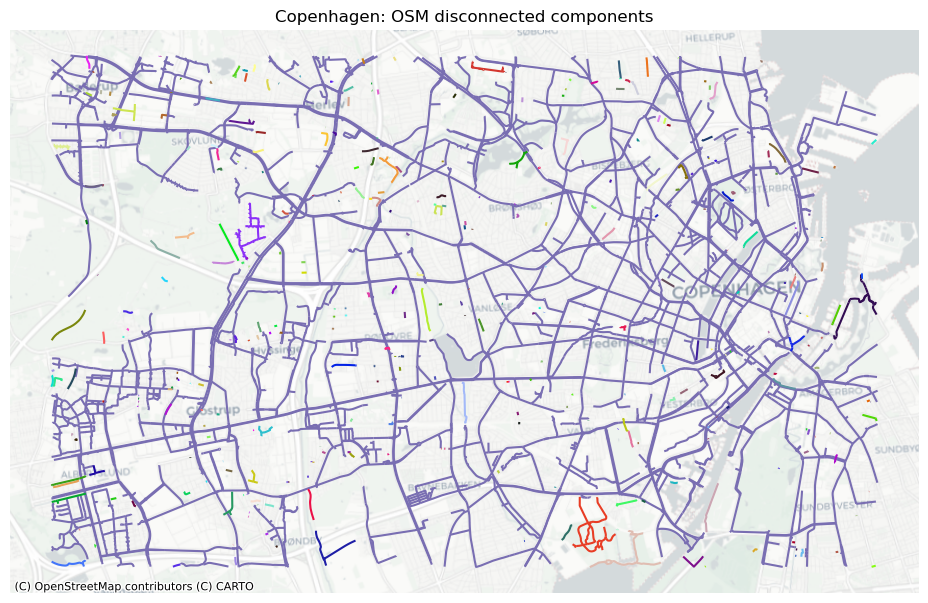

In [38]:
# Plot disconnected components

set_renderer(renderer_map)

# set seed for colors
np.random.seed(42)

# generate enough random colors to plot all components
randcols = np.random.rand(len(osm_components), 3)
randcols[0, :] = col_to_rgb(pdict['osm_base'])

fig, ax = plt.subplots(1, 1, figsize=pdict["fsmap"])

ax.set_title(f"{area_name}: OSM disconnected components")

ax.set_axis_off()

for j, c in enumerate(osm_components):
    if len(c.edges) > 0:
        edges = ox.graph_to_gdfs(c, nodes=False)
        edges.plot(ax=ax, color=randcols[j])

cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)

plot_func.save_fig(fig, osm_results_static_maps_fp + "all_components_osm")

### 每个网格单元的组件

In [39]:
# Assign component ids to grid

grid = eval_func.assign_component_id_to_grid(
    osm_edges_simplified,
    osm_edges_simp_joined,
    osm_components,
    grid,
    prefix="osm",
    edge_id_col="edge_id",
)

fill_na_dict = {"component_ids_osm": ""}
grid.fillna(value=fill_na_dict, inplace=True)

grid["component_count_osm"] = grid.component_ids_osm.apply(lambda x: len(x))


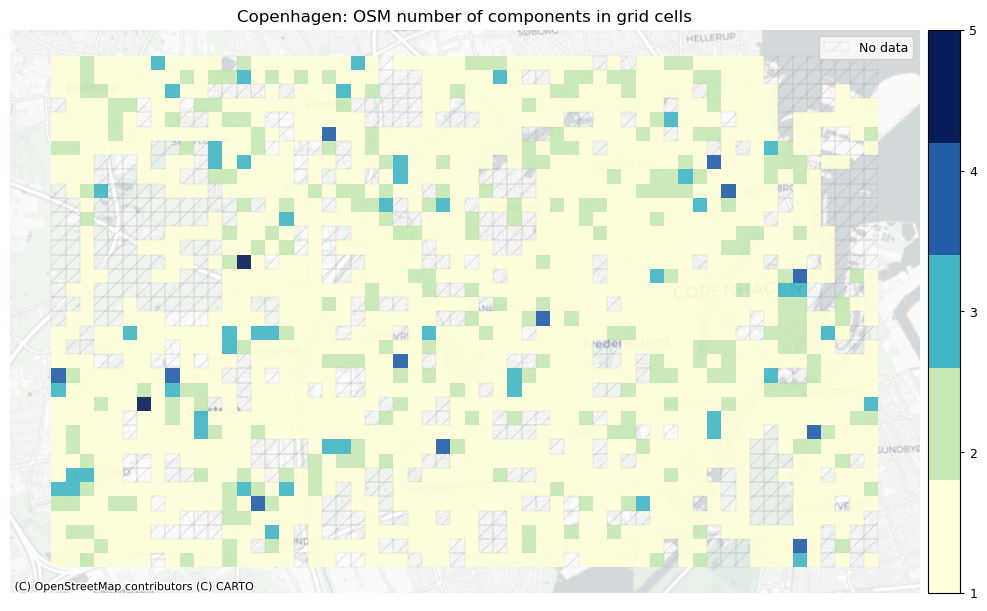

In [40]:
# Plot number of components per grid cell

set_renderer(renderer_map)

fig, ax = plt.subplots(1, 1, figsize=pdict["fsmap"])

ncolors = grid["component_count_osm"].max()

from mpl_toolkits.axes_grid1 import make_axes_locatable
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="3.5%", pad="1%")

mycm = cm.get_cmap(pdict["seq"], ncolors) 
grid[grid.component_count_osm>0].plot(
    cax=cax,
    ax=ax,
    column="component_count_osm",
    legend=True,
    legend_kwds={'ticks': list(range(1, ncolors+1))},
    cmap=mycm,
    alpha=pdict["alpha_grid"],
)

# add no data patches
grid[grid["count_osm_edges"].isnull()].plot(
    cax=cax,
    ax=ax,
    facecolor=pdict["nodata_face"],
    edgecolor=pdict["nodata_edge"],
    linewidth= pdict["line_nodata"],
    hatch=pdict["nodata_hatch"],
    alpha=pdict["alpha_nodata"],
)

ax.legend(handles=[nodata_patch], loc="upper right")

cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)
ax.set_title(area_name + ": OSM number of components in grid cells")
ax.set_axis_off()

plot_func.save_fig(fig, osm_results_static_maps_fp + f"number_of_components_in_grid_cells_osm")

### 组件长度分布

所有网络组件长度的分布可以在所谓的 *Zipf 图* 中可视化，该图按等级对每个组件的长度进行排序，在左侧显示最大组件的长度，然后是第二大组件的长度，依此类推，直到 右侧最小组件的长度。 当 Zipf 图遵循 [双对数比例](https://en.wikipedia.org/wiki/Logarithmic_scale) 中的直线时，这意味着找到小的不连续组件的机会比传统分布的预期要高得多  [(Clauset et al., 2009)]( https://epubs.siam.org/doi/abs/10.1137/070710111)。 这可能意味着网络没有合并，只有分段或随机添加 [(Szell et al., 2022)](https://www.nature.com/articles/s41598-022-10783-y)，或者数据本身存在许多间隙和拓扑错误，导致小的断开组件。

但是，也可能发生最大的连通分量（图中最左边的标记，等级为 $10^0$）是明显的异常值，而图的其余部分则遵循不同的形状。 这可能意味着在基础设施层面，大部分基础设施已连接到一个大型组件，并且数据反映了这一点 - 即数据在很大程度上没有受到间隙和缺失链接的影响。

自行车网络也可能介于两者之间，有几个大型组件作为异常值。

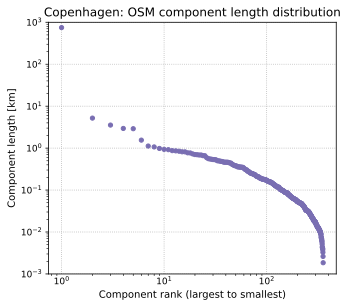

In [41]:
# Zipf plot of component lengths

set_renderer(renderer_plot)

components_length = {}
for i, c in enumerate(osm_components):
    c_length = 0
    for (u, v, l) in c.edges(data="length"):
        c_length += l
    components_length[i] = c_length

components_df = pd.DataFrame.from_dict(components_length, orient="index")
components_df.rename(columns={0: "component_length"}, inplace=True)

fig = plt.figure(figsize=pdict["fsbar_small"])
axes = fig.add_axes([0, 0, 1, 1])

axes.set_axisbelow(True)
axes.grid(True,which="major",ls="dotted")
yvals = sorted(list(components_df["component_length"] / 1000), reverse = True)
axes.scatter(
    x=[i+1 for i in range(len(components_df))],
    y=yvals,
    s=18,
    color=pdict["osm_base"],
)
axes.set_ylim(ymin=10**math.floor(math.log10(min(yvals))), ymax=10**math.ceil(math.log10(max(yvals))))
axes.set_xscale("log")
axes.set_yscale("log")

axes.set_ylabel("Component length [km]")
axes.set_xlabel("Component rank (largest to smallest)")
axes.set_title(area_name+": OSM component length distribution")

plot_func.save_fig(fig, osm_results_plots_fp + "component_length_distribution_osm")

### 最大连通分量

In [42]:
largest_cc = max(osm_components, key=len)

largest_cc_length = 0

for (u, v, l) in largest_cc.edges(data="length"):

    largest_cc_length += l

largest_cc_pct = largest_cc_length / components_df["component_length"].sum() * 100

print(
    f"The largest connected component contains {largest_cc_pct:.2f}% of the network length."
)

# Get edges in largest cc
lcc_edges = ox.graph_to_gdfs(
    G=largest_cc, nodes=False, edges=True, node_geometry=False, fill_edge_geometry=False
)

# Export to GPKG
lcc_edges[["edge_id", "geometry"]].to_file(
    osm_results_data_fp + "largest_connected_component.gpkg"
)

The largest connected component contains 91.47% of the network length.


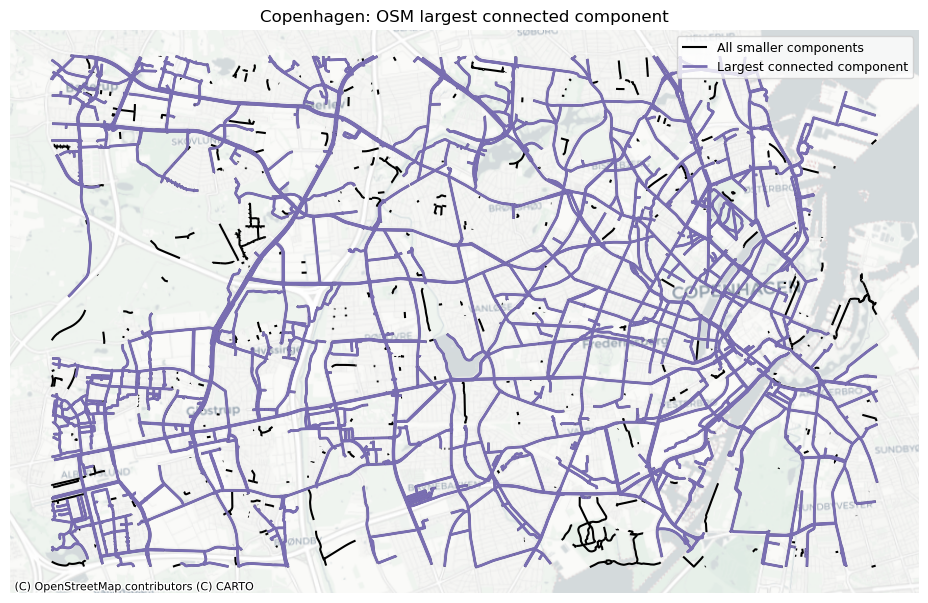

In [43]:
# Plot of largest connected component

set_renderer(renderer_map)
fig, ax = plt.subplots(1, 1, figsize=pdict["fsmap"])
osm_edges_simplified.plot(ax=ax, color = pdict["base"], linewidth = 1.5, label = "All smaller components")
lcc_edges.plot(ax=ax, color=pdict["osm_base"], linewidth = 2, label = "Largest connected component")
grid.plot(ax=ax,alpha=0)
ax.set_axis_off()
ax.set_title(area_name + ": OSM largest connected component")
ax.legend()

cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)

plot_func.save_fig(fig, osm_results_static_maps_fp + f"largest_conn_comp_osm")

In [44]:
# Save plot without basemap for potential report titlepage

set_renderer(renderer_map)
fig, ax = plt.subplots(1, 1, figsize=pdict["fsmap"])
osm_edges_simplified.plot(ax=ax, color = pdict["base"], linewidth = 1.5, label = "Disconnected components")
lcc_edges.plot(ax=ax, color=pdict["osm_base"], linewidth = 2, label = "Largest connected component")
ax.set_axis_off()

plot_func.save_fig(fig, osm_results_static_maps_fp + f"titleimage",plot_res="high")
plt.close()

### 缺少链接

在组件之间潜在缺失链接的图中，将绘制与另一个组件上的边的指定距离内的所有边。 断开的边缘之间的间隙用标记突出显示。 因此，该地图突出显示了边缘，尽管这些边缘彼此非常接近，但它们是断开连接的，因此不可能在边缘之间的自行车基础设施上骑自行车。

<div class="alert alert-block alert-info">
<b>User configuration</b>
<p>
在分析组件之间潜在的缺失链接时，用户必须定义两个组件之间的距离被认为足够低以至于怀疑数字化错误的阈值。
    </p>
</div>

In [45]:
# DEFINE MAX BUFFER DISTANCE BETWEEN COMPONENTS CONSIDERED A GAP/MISSING LINK
component_min_distance = 10

assert isinstance(component_min_distance, int) or isinstance(
    component_min_distance, float
), print("Setting must be integer or float value!")

print(f"Running analysis with component distance threshold of {component_min_distance} meters.")

Running analysis with component distance threshold of 10 meters.


In [46]:
component_gaps = eval_func.find_adjacent_components(
    components=osm_components,
    buffer_dist=component_min_distance,
    crs=study_crs,
    edge_id="edge_id",
)
component_gaps_gdf = gpd.GeoDataFrame.from_dict(
    component_gaps, orient="index", geometry="geometry", crs=study_crs
)

edge_ids = set(
    component_gaps_gdf["edge_id" + "_left"].to_list()
    + component_gaps_gdf["edge_id" + "_right"].to_list()
)

edge_ids = [int(i) for i in edge_ids]
edges_with_gaps = osm_edges_simplified.loc[osm_edges_simplified.edge_id.isin(edge_ids)]

In [47]:
# Save to csv
pd.DataFrame(edge_ids, columns=["edge_id"]).to_csv(
    osm_results_data_fp + f"component_gaps_edges_{component_min_distance}.csv",
    index=False,
)

# Export gaps to GPKG
component_gaps_gdf.to_file(
    osm_results_data_fp + f"component_gaps_centroids_{component_min_distance}.gpkg"
)

In [48]:
# Interactive plot of adjacent, potentially disconnected components

if len(component_gaps) > 0:

    simplified_edges_folium = plot_func.make_edgefeaturegroup(
        gdf=osm_edges_simplified,
        mycolor=pdict["osm_base"],
        myweight=pdict["line_base"],
        nametag="All edges",
        show_edges=True,
    )

    component_issues_edges_folium = plot_func.make_edgefeaturegroup(
        gdf=edges_with_gaps,
        mycolor=pdict["osm_emp"],
        myweight=pdict["line_emp"],
        nametag="Adjacent disconnected edges",
        show_edges=True,
    )

    component_issues_gaps_folium = plot_func.make_markerfeaturegroup(
        gdf=component_gaps_gdf, nametag="Component gaps", show_markers=True
    )

    m = plot_func.make_foliumplot(
        feature_groups=[
            simplified_edges_folium,
            component_issues_edges_folium,
            component_issues_gaps_folium,
        ],
        layers_dict=folium_layers,
        center_gdf=osm_nodes_simplified,
        center_crs=osm_nodes_simplified.crs,
    )

    bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
    m.fit_bounds(bounds)

    m.save(osm_results_inter_maps_fp + f"component_gaps_{component_min_distance}_osm.html")

    display(m)

In [49]:
if len(component_gaps) > 0:
    print("Interactive map saved at " + osm_results_inter_maps_fp.lstrip("../") + f"component_gaps_{component_min_distance}_osm.html")
else:
    print("There are no component gaps to plot.")

Interactive map saved at results/OSM/cph_geodk/maps_interactive/component_gaps_10_osm.html


### 组件连接

在这里，我们可视化每个单元格可以到达的单元格数量之间的差异。 这是对网络连接性的粗略测量，但具有计算成本低的优点，因此能够快速突出网络连接性的明显差异。

In [50]:
osm_components_cell_count = eval_func.count_component_cell_reach(
    components_df, grid, "component_ids_osm"
)
grid["cells_reached_osm"] = grid["component_ids_osm"].apply(
    lambda x: eval_func.count_cells_reached(x, osm_components_cell_count)
    if x != ""
    else 0
)

grid["cells_reached_osm_pct"] = grid.apply(
    lambda x: np.round((x.cells_reached_osm / len(grid)) * 100, 2), axis=1
)

grid.loc[grid["cells_reached_osm_pct"] == 0, "cells_reached_osm_pct"] = np.NAN

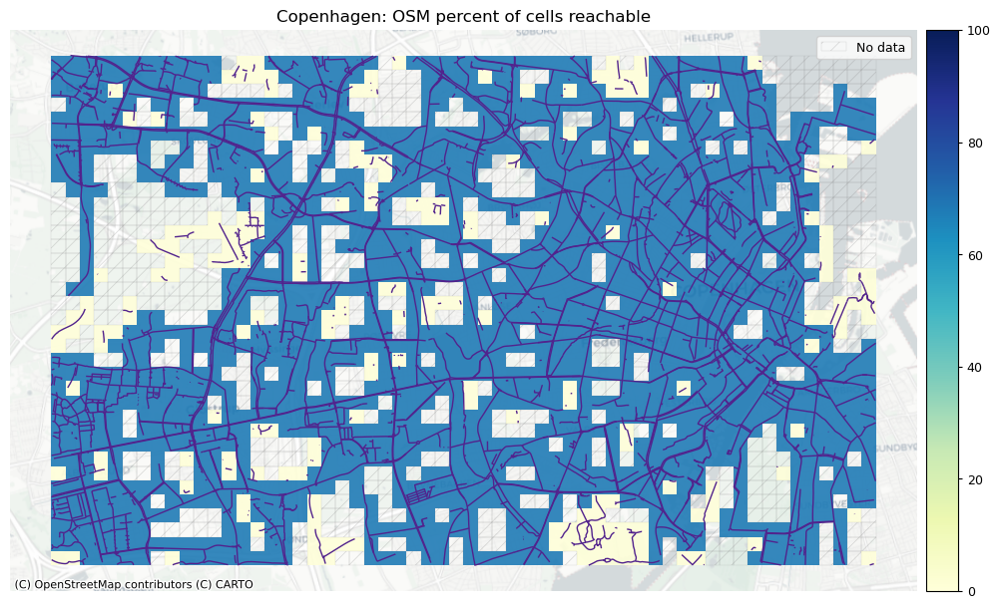

In [51]:
# Plot percent of cells reachable

set_renderer(renderer_map)
fig, ax = plt.subplots(1, 1, figsize=pdict["fsmap"])

# norm for color bars
cbnorm_reach = colors.Normalize(vmin=0, vmax=100)

from mpl_toolkits.axes_grid1 import make_axes_locatable
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="3.5%", pad="1%")

grid[grid.cells_reached_osm_pct > 0].plot(
    cax=cax,
    ax=ax,
    column="cells_reached_osm_pct",
    legend=True,
    cmap=pdict["seq"],
    norm=cbnorm_reach,
    alpha=pdict["alpha_grid"],
)

osm_edges_simplified.plot(ax=ax, color=pdict["osm_emp"], linewidth=1)

# add no data patches
grid[grid["count_osm_edges"].isnull()].plot(
    cax=cax,
    ax=ax,
    facecolor=pdict["nodata_face"],
    edgecolor=pdict["nodata_edge"],
    linewidth= pdict["line_nodata"],
    hatch=pdict["nodata_hatch"],
    alpha=pdict["alpha_nodata"],
)

ax.legend(handles=[nodata_patch], loc="upper right")

cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)
ax.set_title(area_name+": OSM percent of cells reachable")
ax.set_axis_off()

plot_func.save_fig(fig, osm_results_static_maps_fp + "percent_cells_reachable_grid_osm")

In [52]:
components_results = {}
components_results["component_count"] = len(osm_components)
components_results["largest_cc_pct_size"] = largest_cc_pct
components_results["largest_cc_length"] = largest_cc_length
components_results["count_component_gaps"] = len(component_gaps)

## 概括

In [53]:
# Print out table summary of results

summarize_results = {**density_results, **components_results}

summarize_results["count_dangling_nodes"] = len(dangling_nodes)
summarize_results["count_intersection_issues"] = count_intersection_issues
summarize_results["count_overshoots"] = len(overshoots)
summarize_results["count_undershoots"] = len(undershoot_nodes)
summarize_results["count_incompatible_tags"] = sum(
    len(lst) for lst in incompatible_tags_results.values()
)

# Add total node count and total infrastructure length
summarize_results["total_nodes"] = len(osm_nodes_simplified)
summarize_results["total_length"] = osm_edges_simplified.infrastructure_length.sum() / 1000

summarize_results_df = pd.DataFrame.from_dict(summarize_results, orient="index")

summarize_results_df.rename({0: " "}, axis=1, inplace=True)

# Convert length to km
summarize_results_df.loc["largest_cc_length"] = (
    summarize_results_df.loc["largest_cc_length"] / 1000
)

summarize_results_df = summarize_results_df.reindex([
    'total_length',
    'protected_density_m_sqkm',
    'unprotected_density_m_sqkm',
    'mixed_density_m_sqkm',
    'edge_density_m_sqkm',
    'total_nodes',
    'count_dangling_nodes',
    'node_density_count_sqkm',
    'dangling_node_density_count_sqkm',
    'count_incompatible_tags',
    'count_overshoots',
    'count_undershoots',
    'count_intersection_issues',
    'component_count',
    'largest_cc_length',
    'largest_cc_pct_size', 
    'count_component_gaps'
     ])

rename_metrics = {
    "total_length": "Total infrastructure length (km)",
    "total_nodes": "Nodes",
    "edge_density_m_sqkm": "Bicycle infrastructure density (m/km2)",
    "node_density_count_sqkm": "Nodes per km2",
    "dangling_node_density_count_sqkm": "Dangling nodes per km2",
    "protected_density_m_sqkm": "Protected bicycle infrastructure density (m/km2)",
    "unprotected_density_m_sqkm": "Unprotected bicycle infrastructure density (m/km2)",
    "mixed_density_m_sqkm": "Mixed protection bicycle infrastructure density (m/km2)",
    "component_count": "Components",
    "largest_cc_pct_size": "Largest component's share of network length",
    "largest_cc_length": "Length of largest component (km)",
    "count_component_gaps": "Component gaps",
    "count_dangling_nodes": "Dangling nodes",
    "count_intersection_issues": "Missing intersection nodes",
    "count_overshoots": "Overshoots",
    "count_undershoots": "Undershoots",
    "count_incompatible_tags": "Incompatible tag combinations",
}

summarize_results_df.rename(rename_metrics, inplace=True)
summarize_results_df.style.pipe(format_osm_style)

,
Total infrastructure length (km),"1,056"
Protected bicycle infrastructure density (m/km2),"5,342"
Unprotected bicycle infrastructure density (m/km2),427
Mixed protection bicycle infrastructure density (m/km2),55
Bicycle infrastructure density (m/km2),"5,825"
Nodes,"5,016"
Dangling nodes,"1,828"
Nodes per km2,28
Dangling nodes per km2,10
Incompatible tag combinations,2


## 保存结果

In [54]:
all_results = {}

all_results["existing_tags"] = existing_tags_results
all_results["incompatible_tags_results"] = incompatible_tags_results
all_results["incompatible_tags_count"] = sum(
    len(lst) for lst in incompatible_tags_results.values()
)
all_results["network_density"] = density_results
all_results["count_intersection_issues"] = count_intersection_issues
all_results["count_overshoots"] = len(overshoots)
all_results["count_undershoots"] = len(undershoot_nodes)
all_results["dangling_node_count"] = len(dangling_nodes)
all_results["simplification_outcome"] = simplification_results
all_results["component_analysis"] = components_results

with open(osm_intrinsic_fp, "w") as outfile:
    json.dump(all_results, outfile)


# Save summary dataframe
summarize_results_df.to_csv(
    osm_results_data_fp + "intrinsic_summary_results.csv", index=True
)

# Save grid with results
with open(osm_intrinsic_grid_fp, "wb") as f:
    pickle.dump(grid, f)

***

In [55]:
from time import strftime
print("Time of analysis: " + strftime("%a, %d %b %Y %H:%M:%S"))

Time of analysis: Mon, 18 Dec 2023 20:12:48
